In [ ]:
import os, sys, re
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt
from matplotlib import gridspec

import importlib
import subprocess

sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '..')))
sys.path.append(os.path.abspath(os.path.join('..', 'preprocessing')))
sys.path.append(os.path.abspath(os.path.join('..', 'cellTV')))

import preprocessing.parse_session_functions_cohort2 as parse_session_functions
import neural_analysis_helpers
import alternation_analysis_helpers as alternation
import cellTV.cellTV_functions_cohort2 as cellTV

importlib.reload(parse_session_functions)
importlib.reload(neural_analysis_helpers)
importlib.reload(alternation)
importlib.reload(cellTV)


<module 'cellTV.cellTV_functions_cohort2' from '/Users/athinaapostolelli/Documents/SWC/VR_ABCD_project/VR_ABCD/cellTV/cellTV_functions_cohort2.py'>

In [9]:
# Define paths
mouse = 'TAA0000066'
base_path = Path('/Volumes/mrsic_flogel/public/projects/AtApSuKuSaRe_20250129_HFScohort2/')

# Path to roicat environment's python (roicat runs on python >= 3.13)
# roicat_env_python = "/Users/athinaapostolelli/miniforge3/envs/roicat/bin/python"
roicat_env_python = "/home/athina/miniforge3/envs/roicat/bin/python"

tracked_neurons = {}

#### Load roicat tracking and alignment data 

In [3]:
# Load roicat tracked neurons
roicat_data_name = mouse 
roicat_dir = base_path / f'{roicat_data_name}' / 'ROICaT'

# Choose sessions and paths for alignment
# sessions_to_align = ['ses-008_date-20250321_protocol-t5', 'ses-009_date-20250323_protocol-t6']

sessions_to_align = ['ses-005_date-20250218_protocol-t0',
    'ses-006_date-20250224_protocol-t1',
    'ses-007_date-20250304_protocol-t2',
    'ses-008_date-20250306_protocol-t3',
    'ses-010_date-20250314_protocol-t4',
    'ses-011_date-20250315_protocol-t5',
    'ses-012_date-20250318_protocol-t6',
    'ses-013_date-20250320_protocol-t7',
    'ses-014_date-20250326_protocol-t8',
    'ses-015_date-20250327_protocol-t9',
    'ses-016_date-20250330_protocol-t10',
    'ses-017_date-20250331_protocol-t11',
    'ses-018_date-20250403_protocol-t12',
    'ses-019_date-20250404_protocol-t13',
    'ses-020_date-20250412_protocol-t14',
    'ses-021_date-20250426_protocol-t15',
    'ses-022_date-20250509_protocol-t16',
    'ses-023_date-20250516_protocol-t17']

protocols = [int(re.search(r'protocol-t(\d+)', s).group(1)) for s in sessions_to_align]
protocols = [protocols[0], protocols[-1]]

alignment_dir = roicat_dir / 'alignment' / '_'.join(f't{n}' for n in protocols)
filename = f"roicat_aligned_ROIs_{'_'.join(['t' + str(n) for n in protocols])}.npy"

# Load aligned cluster ids
if os.path.exists(os.path.join(alignment_dir, filename)):
    print('Aligned clusters already found. Loading...')
    idx_original_aligned = np.load(os.path.join(alignment_dir, filename))
else:
    print('You first need to align the clusters across sessions e.g. using roi_tracking_helpers/align_rois')

Aligned clusters already found. Loading...


#### T3

DF_F0 file found. Loading...
(591, 78628)
Training and Imaging
Total rewards considered here:  38
Total rewards not considered here:  9
Total assistant and manual rewards:  9
Reward time lag from lm entry:  17.0
Total licks considered here:  1080


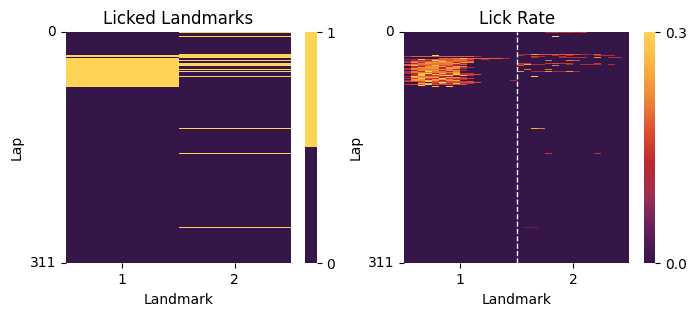

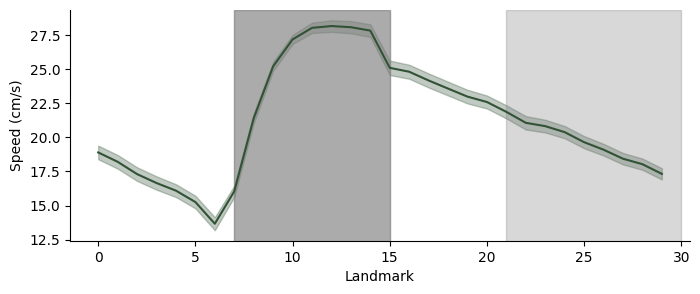

Number of laps =  4


NameError: name 'idx_original_aligned' is not defined

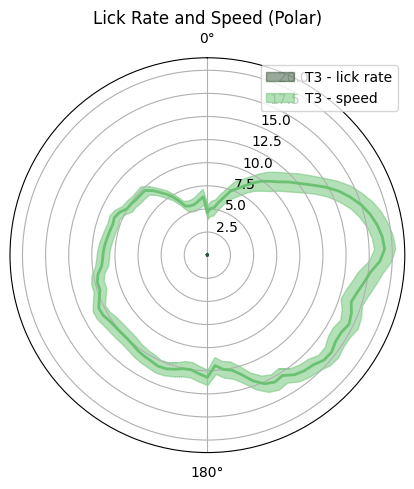

In [27]:
# Define paths
save_path3, dF_3, session3 = neural_analysis_helpers.load_dF_session_data(base_path, mouse, stage='-t3')

# Ignore last few laps when the mouse wasn't really licking even in goal lms - arbitrarily choose idx=160
lick_end_idx = 160
event_idx3 = np.sort(np.concatenate([session3['reward_idx'], session3['miss_rew_idx'], session3['nongoal_rew_idx']])).astype(int)[:lick_end_idx]
session3['event_idx'] = event_idx3

lick_neuron = np.array(session3['frame_lick_rate'][:event_idx3[-1]]).reshape(1, -1)
speed_neuron = np.array(session3['speed'][:event_idx3[-1]]).reshape(1, -1)

_ = cellTV.plot_arb_progress_2cells(dF=[lick_neuron, speed_neuron], cell=[0, 0], sessions=[session3, session3],
                                event_frames=[event_idx3, event_idx3], ngoals=2, 
                                bins=45, stages=np.array([3, 3]), labels=['T3 - lick rate', 'T3 - speed'], 
                                plot=True, shuffle=False)

tracked_neurons[3] = idx_original_aligned[3][~np.isnan(idx_original_aligned[3])].astype(int)

In [ ]:
# Get goal progress neurons
neurons = tracked_neurons[3]
dF = dF_3
session = session3
event_idx = np.sort(np.concatenate([session['reward_idx'], session['miss_rew_idx'], session['nongoal_rew_idx']])).astype(int)[:lick_end_idx]

goal_progress_tuned_t3 = neural_analysis_helpers.get_goal_progress_cells(dF, neurons, session, 
                                                                         event_frames=event_idx, stage=3, 
                                                                         save_path=save_path3, ngoals=2, bins=45, 
                                                                         period='goal', reload=False, 
                                                                         plot=True, shuffle=True)

In [ ]:
# Get period-2 progress neurons 
neurons = tracked_neurons[3]
dF = dF_3
session = session3
event_idx = np.sort(np.concatenate([session['reward_idx'], session['miss_rew_idx'], session['nongoal_rew_idx']])).astype(int)[:lick_end_idx]

period2_progress_tuned_t3 = neural_analysis_helpers.get_goal_progress_cells(dF, neurons, session, 
                                                                         event_frames=event_idx, stage=3, 
                                                                         save_path=save_path3, ngoals=2, bins=45, 
                                                                         period='landmark', reload=True, 
                                                                         plot=True, shuffle=True)

In [ ]:
for cell in goal_progress_tuned_t3:
    _ = cellTV.plot_arb_progress_2cells(dF=[dF_3, lick_neuron], cell=[cell, 0], sessions=[session3, session3], 
                                        event_frames=[event_idx, event_idx], ngoals=2, bins=45, 
                                        period='goal', stages=[3, 3], plot=True, plot_firing=True, 
                                        labels=[f'T3 - cell {cell}', 'T3 - lick rate'])

In [ ]:
for cell in period2_progress_tuned_t3:
    _ = cellTV.plot_arb_progress_2cells(dF=[dF_3, lick_neuron], cell=[cell, 0], sessions=[session3, session3], 
                                            event_frames=[event_idx, event_idx], ngoals=2, bins=45, 
                                            period='landmark', stages=[3, 3], plot=True, plot_firing=True, 
                                            labels=[f'T3 - cell {cell}', 'T3 - lick rate'])

In [ ]:
# 348, 573??

for cell in neurons:
    _ = cellTV.extract_arb_progress(dF, cell, session, event_idx, 2, 45, period='landmark', stage=3, plot=True, shuffle=False)

In [ ]:
# Get period-3 progress neurons 
tracked_neurons[3] = idx_original_aligned[3][~np.isnan(idx_original_aligned[3])].astype(int)
neurons = tracked_neurons[3]
dF = dF_3
session = session3
event_idx = np.sort(np.concatenate([session['reward_idx'], session['miss_rew_idx'], session['nongoal_rew_idx']])).astype(int)[:lick_end_idx]

period3_progress_tuned_t3 = neural_analysis_helpers.get_goal_progress_cells(dF, neurons, session, 
                                                                         event_frames=event_idx, stage=3, 
                                                                         save_path=save_path3, ngoals=3, bins=45, 
                                                                         period='landmark', reload=False, 
                                                                         plot=True, shuffle=True)

In [ ]:
# Get period-4 progress neurons 
tracked_neurons[3] = idx_original_aligned[3][~np.isnan(idx_original_aligned[3])].astype(int)
neurons = tracked_neurons[3]
dF = dF_3
session = session3
event_idx = np.sort(np.concatenate([session['reward_idx'], session['miss_rew_idx'], session['nongoal_rew_idx']])).astype(int)[:lick_end_idx]

period4_progress_tuned_t3 = neural_analysis_helpers.get_goal_progress_cells(dF, neurons, session, 
                                                                         event_frames=event_idx, stage=3, 
                                                                         save_path=save_path3, ngoals=4, bins=45, 
                                                                         period='landmark', reload=True, 
                                                                         plot=True, shuffle=True)

#### T4

DF_F0 file found. Loading...
(550, 79300)
Training and Imaging
Total rewards considered here:  126
Total rewards not considered here:  0
Total assistant and manual rewards:  0
Total rewards considered here:  126
Total rewards not considered here:  0
Total assistant and manual rewards:  0
Reward time lag from lm entry:  18.0
Total licks considered here:  3436


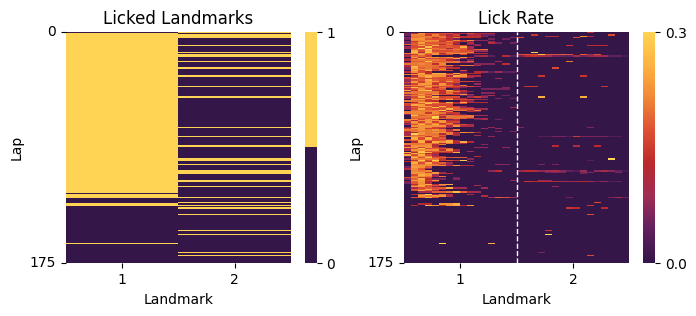

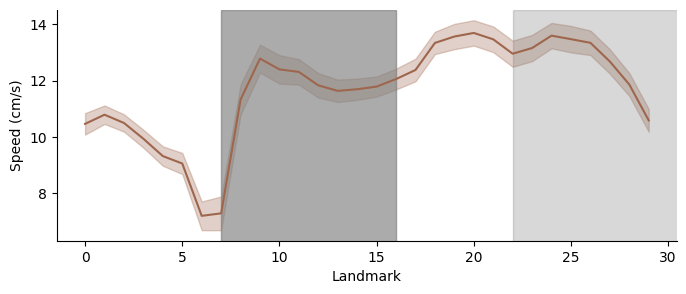

Number of laps =  1


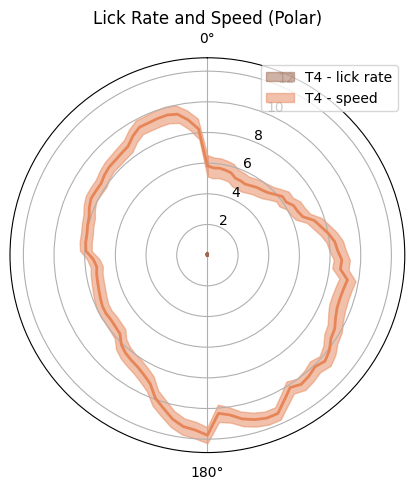

In [94]:
# Define paths
save_path4, dF_4, session4 = neural_analysis_helpers.load_dF_session_data(base_path, mouse, stage='-t4')

event_idx4 = np.sort(np.concatenate([session4['reward_idx'], session4['miss_rew_idx'], session4['nongoal_rew_idx']])).astype(int)#[:lick_end_idx]
session4['event_idx'] = event_idx4

lick_neuron = np.array(session4['frame_lick_rate'][:event_idx4[-1]]).reshape(1, -1)
speed_neuron = np.array(session4['speed'][:event_idx4[-1]]).reshape(1, -1)

_ = cellTV.plot_arb_progress_2cells(dF=[lick_neuron, speed_neuron], cell=[0, 0], sessions=[session4, session4],
                                event_frames=[event_idx4, event_idx4], ngoals=2, 
                                bins=45, stages=np.array([4, 4]), labels=['T4 - lick rate', 'T4 - speed'], 
                                plot=True, shuffle=False)

tracked_neurons[4] = idx_original_aligned[4][~np.isnan(idx_original_aligned[4])].astype(int)


##### Goal progress and periodicity

In [ ]:
# Get goal progress neurons
neurons = tracked_neurons[4]
dF = dF_4
session = session4
event_idx = np.sort(np.concatenate([session['reward_idx'], session['miss_rew_idx'], session['nongoal_rew_idx']])).astype(int)

goal_progress_tuned_t4 = neural_analysis_helpers.get_goal_progress_cells(dF, neurons, session, 
                                                                         event_frames=event_idx, stage=4, 
                                                                         save_path=save_path4, ngoals=2, bins=45, 
                                                                         period='goal', reload=False, 
                                                                         plot=True, shuffle=True)

In [ ]:
# Get period-2 progress neurons 
neurons = tracked_neurons[4]
dF = dF_4
session = session4
event_idx = np.sort(np.concatenate([session['reward_idx'], session['miss_rew_idx'], session['nongoal_rew_idx']])).astype(int)

period2_progress_tuned_t4 = neural_analysis_helpers.get_goal_progress_cells(dF, neurons, session, 
                                                                         event_frames=event_idx, stage=4, 
                                                                         save_path=save_path4, ngoals=2, bins=45, 
                                                                         period='landmark', reload=False, 
                                                                         plot=True, shuffle=True)

In [ ]:
# Get period-3 progress neurons 
tracked_neurons[4] = idx_original_aligned[4][~np.isnan(idx_original_aligned[4])].astype(int)
neurons = tracked_neurons[4]
dF = dF_4
session = session4
event_idx = np.sort(np.concatenate([session['reward_idx'], session['miss_rew_idx'], session['nongoal_rew_idx']])).astype(int)

period3_progress_tuned_t4 = neural_analysis_helpers.get_goal_progress_cells(dF, neurons, session, 
                                                                         event_frames=event_idx, stage=4, 
                                                                         save_path=save_path4, ngoals=3, bins=45, 
                                                                         period='landmark', reload=True, 
                                                                         plot=True, shuffle=True)

In [ ]:
for cell in tracked_neurons[4]:
    _ = cellTV.extract_arb_progress(dF, cell, session, event_idx, ngoals=2, bins=45, period='landmark', stage=4, plot=True)

In [ ]:
# List of T4 cells I think are landmark tuned (active for both lms)
# 521, 4569, 405, 2, 34, 322, 1, 160, 165, 225, 192, 365, 332, 317, 389, 399, 311, 408, 224, 466, 485, 246, 380, 280, 266, 318, 287, 82, 188, 432, 296, 299, 469, 35
dF = dF_4
session = session4
event_idx = np.sort(np.concatenate([session['reward_idx'], session['miss_rew_idx'], session['nongoal_rew_idx']])).astype(int)

my_landmark_tuning = [521, 459, 405, 2, 34, 322, 1, 160, 165, 225, 192, 365, 332, 317, 389, 399, 311, 408, 224, 466, 485, 246, 380, 280, 266, 318, 287, 82, 188, 432, 296, 299, 469, 35]

real_scores = []
shuffled_scores = []
for cell in my_landmark_tuning:
    real_score, shuffled_score, phase_pref, state_pref = cellTV.calc_goal_tuningix(dF, cell, session, condition='arb', period='landmark', event_frames=event_idx, n_goals=2, frame_rate=45, bins=45, shuffle=True, plot=True)
    real_scores.append(real_score)
    shuffled_scores.append(shuffled_score)

In [ ]:
correctly_identified = []
for i, cell in enumerate(my_landmark_tuning):
    if real_scores[i] - np.median(shuffled_scores[i]) > 0.07:
        _ = cellTV.extract_arb_progress(dF, cell, session, event_idx, ngoals=2, bins=45, period='landmark', stage=4, plot=True)
        correctly_identified.append(cell)

print(len(correctly_identified), len(my_landmark_tuning))

excluded = np.setdiff1d(my_landmark_tuning, correctly_identified)

for cell in excluded:
    real_score, shuffled_score, phase_pref, state_pref = cellTV.calc_goal_tuningix(dF, cell, session, condition='arb', period='landmark', event_frames=event_idx, n_goals=2, frame_rate=45, bins=45, shuffle=True, plot=True)
    _ = cellTV.extract_arb_progress(dF, cell, session, event_idx, ngoals=2, bins=45, period='landmark', stage=4, plot=True)

In [ ]:
for cell in goal_progress_tuned_t4:
    _ = cellTV.plot_arb_progress_2cells(dF=[dF_4, lick_neuron], cell=[cell, 0], sessions=[session4, session4], 
                                        event_frames=[event_idx, event_idx], ngoals=2, bins=45, 
                                        period='goal', stages=[4, 4], plot=True, plot_firing=True, 
                                        labels=[f'T4 - cell {cell}', 'T4 - lick rate'])

In [ ]:
for cell in period2_progress_tuned_t4:
    _ = cellTV.plot_arb_progress_2cells(dF=[dF_4, lick_neuron], cell=[cell, 0], sessions=[session4, session4], 
                                            event_frames=[event_idx, event_idx], ngoals=2, bins=45, 
                                            period='landmark', stages=[4, 4], plot=True, plot_firing=True, 
                                            labels=[f'T4 - cell {cell}', 'T4 - lick rate'])

In [ ]:
common_cells = np.intersect1d(goal_progress_tuned_t4, period2_progress_tuned_t4)
print(len(common_cells) / len(period2_progress_tuned_t4))

goal_cells = np.setdiff1d(goal_progress_tuned_t4, period2_progress_tuned_t4)
print(goal_cells)

for cell in goal_cells:
    if np.isin(cell, [91, 365, 413, 485]):
        _ = cellTV.plot_arb_progress_2cells(dF=[dF_4, lick_neuron], cell=[cell, 0], sessions=[session4, session4], 
                                            event_frames=[event_idx, event_idx], ngoals=2, bins=45, 
                                            period='landmark', stages=[4, 4], plot=True, plot_firing=True, 
                                            labels=[f'T4 - cell {cell}', 'T4 - lick rate'])

In [ ]:
for cell in goal_cells:
    _ = cellTV.plot_arb_progress_2cells(dF=[dF_4, lick_neuron], cell=[cell, 0], sessions=[session4, session4], 
                                            event_frames=[event_idx, event_idx], ngoals=2, bins=45, 
                                            period='goal', stages=[4, 4], plot=True, plot_firing=True, 
                                            labels=[f'T4 - cell {cell}', 'T4 - lick rate'])

In [ ]:
for cell in tracked_neurons[4]:
    if np.isin(cell, [91, 322, 469, 34, 521, 160, 192, 469]):
        _ = cellTV.plot_arb_progress_2cells(dF=[dF_4, lick_neuron], cell=[cell, 0], sessions=[session4, session4], 
                                            event_frames=[event_idx, event_idx], ngoals=2, bins=45, 
                                            period='goal', stages=[4, 4], plot=True, plot_firing=True, 
                                            labels=[f'T4 - cell {cell}', 'T4 - lick rate'])

In [ ]:
for cell in tracked_neurons[4]:
    if np.isin(cell, [91, 322, 469, 34, 521, 160, 192, 469]):
        _ = cellTV.plot_arb_progress_2cells(dF=[dF_4, lick_neuron], cell=[cell, 0], sessions=[session4, session4], 
                                            event_frames=[event_idx, event_idx], ngoals=2, bins=45, 
                                            period='landmark', stages=[4, 4], plot=True, plot_firing=True, 
                                            labels=[f'T4 - cell {cell}', 'T4 - lick rate'])

#### What are T5/T6 goal progress cells doing here? 

Load T6 goal-progress data

DF_F0 file found. Loading...
(549, 119202)
Training and Imaging
Total rewards considered here:  178
Total rewards not considered here:  0
Total assistant and manual rewards:  0
Total rewards considered here:  178
Total rewards not considered here:  0
Total assistant and manual rewards:  0
Reward time lag from lm entry:  24.0
Total licks considered here:  3401


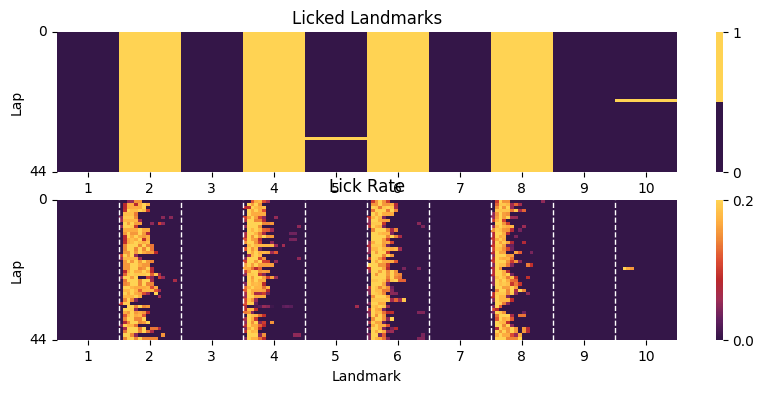

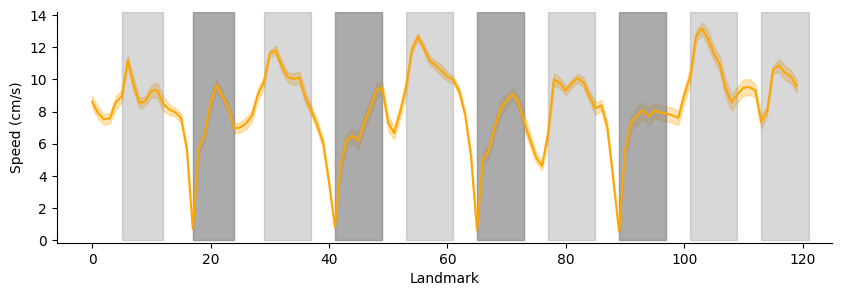

Number of laps =  1


In [292]:
save_path6, dF_6, session6 = neural_analysis_helpers.load_dF_session_data(base_path, mouse, stage='-t6')

In [293]:
# Goal progress - 5 goals

# Get the neurons in this session that have been tracked with roicat
session_idx = 6
tracked_neurons[session_idx] = idx_original_aligned[session_idx][~np.isnan(idx_original_aligned[session_idx])].astype(int)

# Find goal progress tuned cells 
event_idx6 = np.sort(np.concatenate([session6['reward_idx'], session6['miss_rew_idx'], session6['test_rew_idx']])).astype(int)

goal_progress_tuned_t6_5g = neural_analysis_helpers.get_goal_progress_cells(dF_6, tracked_neurons[session_idx], session6, \
                                              event_frames=event_idx6, stage=6, \
                                                save_path=save_path6, ngoals=5, bins=90, plot=True, \
                                                    shuffle=True, reload=False)

Goal progress and tracked neurons found. Loading...
139 out of 386 tracked neurons are goal progress tuned in T6


Load T5 goal-progress data

DF_F0 file found. Loading...
(624, 78437)
Training and Imaging
Total rewards considered here:  101
Total rewards not considered here:  9
Total assistant and manual rewards:  9
Total rewards considered here:  101
Total rewards not considered here:  9
Total assistant and manual rewards:  9
Reward time lag from lm entry:  29.0
Total licks considered here:  2694


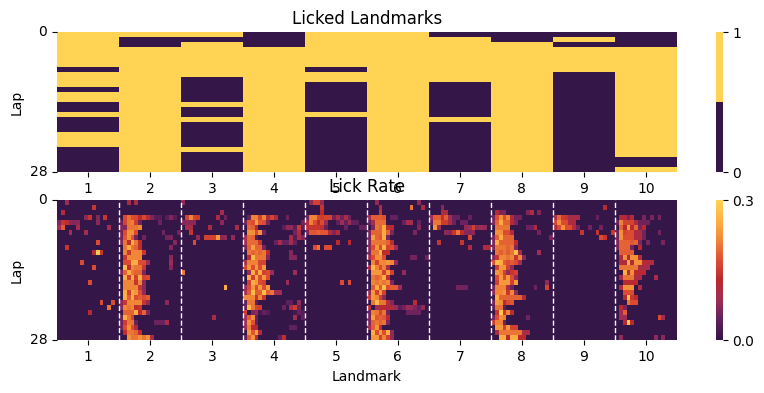

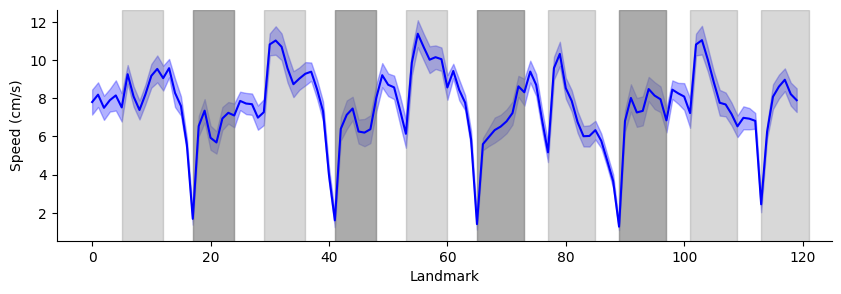

Number of laps =  1


In [294]:
save_path5, dF_5, session5 = neural_analysis_helpers.load_dF_session_data(base_path, mouse, stage='-t5')

In [296]:
# Goal progress - 5 goals

# Get the neurons in this session that have been tracked with roicat
session_idx = 5
tracked_neurons[session_idx] = idx_original_aligned[session_idx][~np.isnan(idx_original_aligned[session_idx])].astype(int)

# Find goal progress tuned cells 
event_idx5 = np.sort(np.concatenate([session5['reward_idx'], session5['miss_rew_idx'], session5['test_rew_idx']])).astype(int)

goal_progress_tuned_t5_5g = neural_analysis_helpers.get_goal_progress_cells(dF_5, tracked_neurons[session_idx], session5, \
                                              event_frames=event_idx5, stage=5, \
                                                save_path=save_path5, ngoals=5, bins=90, plot=True, \
                                                    shuffle=True, reload=False)

Goal progress and tracked neurons found. Loading...
122 out of 491 tracked neurons are goal progress tuned in T5


What are T6 5-peak cells doing in T3/T4?

In [297]:
# Load categories of cells
save_path = Path(os.path.join(base_path, mouse)) / 't5_t6' / 'goal_progress' 

if os.path.exists(os.path.join(save_path, 'T5_T6_4peak_5peak_neurons.npz')):
    print('Found data. Loading...')
    data = np.load(os.path.join(save_path, 'T5_T6_4peak_5peak_neurons.npz')) 
    still_four_peaks = data['four_peaks']
    still_five_peaks = data['five_peaks']
    four_to_five_peaks = data['four_to_five_peaks']
    five_to_four_peaks = data['five_to_four_peaks']

Found data. Loading...


In [ ]:
# Find matching cells 
t6_5peaks = still_five_peaks[:,1]

t6_neurons_idx = np.where(np.isin(idx_original_aligned[6], t6_5peaks))[0]
valid_neuron_mask = ~np.isnan(idx_original_aligned[4][t6_neurons_idx])
valid_neuron_idx = t6_neurons_idx[valid_neuron_mask] 

matching_t6_neurons = idx_original_aligned[6][valid_neuron_idx].astype(int)
matching_t4_neurons = idx_original_aligned[4][valid_neuron_idx].astype(int)

# Get relevant event data
event_idx6 = np.sort(np.concatenate([session6['reward_idx'], session6['miss_rew_idx'], session6['test_rew_idx']])).astype(int)
event_idx4 = np.sort(np.concatenate([session4['reward_idx'], session4['miss_rew_idx'], session4['nongoal_rew_idx']])).astype(int)

# Plot T6 and T4 activity together
for c, cell6, cell4 in zip(valid_neuron_idx, matching_t6_neurons, matching_t4_neurons):

    fig, axs = plt.subplots(1, 2, subplot_kw={'projection':'polar'}, figsize=(6, 3), facecolor='none')
    neural_analysis_helpers.plot_arb_progress(dF_6, cell6, event_frames=event_idx6, ngoals=5, bins=90, 
                                              stage=6, session=session6, labels=f'T6 cell {c}', ax=axs[0])

    neural_analysis_helpers.plot_arb_progress(dF_4, cell4, event_frames=event_idx4, ngoals=2, bins=90, 
                                              stage=4, session=session4, period='landmark', labels=f'T4 cell {c}', ax=axs[-1])
    
    plt.tight_layout()


#### ABAB patches inside T3/T4

In [ ]:
# Find patches of alternating AB/BA 
patches, AB_patches, BA_patches, patches_idx, AB_patches_idx, BA_patches_idx = alternation.get_repeating_XY_patches(session4, min_length=2)


In [ ]:
# Fins patching neurons across sessions
event_idx4 = np.sort(np.concatenate([session4['reward_idx'], session4['miss_rew_idx'], session4['nongoal_rew_idx']])).astype(int)
tracked_neurons[4] = idx_original_aligned[4][~np.isnan(idx_original_aligned[4])].astype(int)

# Get neurons that are 5-peak in T6
t6_5peaks = still_five_peaks[:,1]

t6_neurons_idx = np.where(np.isin(idx_original_aligned[6], t6_5peaks))[0]
valid_neuron_mask = ~np.isnan(idx_original_aligned[4][t6_neurons_idx])
valid_neuron_idx = t6_neurons_idx[valid_neuron_mask] 

matching_t6_neurons = idx_original_aligned[6][valid_neuron_idx].astype(int)
matching_t4_neurons = idx_original_aligned[4][valid_neuron_idx].astype(int)

Compare the signal in second to last, last and test lm across patches

In [ ]:
# Using all neurons 
n_bins = np.min(np.diff(event_idx4)) 
time_around = np.round((n_bins / 45) / 2, 2)

next_lm_data, lm_data, prev_lm_data = alternation.compare_lms_in_AB_patches(tracked_neurons[4], session4, patches, 
                                                                AB_patches, BA_patches,
                                                                dF_4, time_around, n_bins=n_bins, plot=True)

In [ ]:
# Using neurons that are 5-peak in T6
next_lm_data, lm_data, prev_lm_data = alternation.compare_lms_in_AB_patches(matching_t4_neurons, session4, patches, 
                                                                AB_patches, BA_patches, dF_4, time_around, 
                                                                n_bins=n_bins, plot=True)

goal_means, non_goal_means = alternation.compute_lm_mean(next_lm_data, lm_data, prev_lm_data) # goal_means[cond][length] is (n_neurons,)


In [ ]:
# In T3/T4 there is no need for the mouse to be properly inside the lm for reward to be triggered. 
# As long as it is below speed threshold and licking, it can receive a reward as soon as it enters the lm. 
occupancy = np.array(lm_exit_idx) - np.array(lm_entry_idx)
occupancy_pre = np.array(event_idx4) - np.array(lm_entry_idx)
occupancy_post = np.array(lm_exit_idx) - np.array(event_idx4)
weird = np.where(occupancy_pre == 0)[0]

start_event, end_event = weird[2]-1, weird[-1]+1
num_events = end_event - start_event

start, end = lm_entry_idx[start_event], lm_exit_idx[end_event]
rewards = [r for r in session4['reward_idx'] if start <= r and end >= r]

fig, ax1 = plt.subplots(figsize=(12, 3))

# Primary y-axis (total distance)
ax1.plot(np.arange(start, end), session4['total_dist'][start:end], color='k', label='Total distance')
ax1.scatter(lm_entry_idx[start_event:end_event+1], 
            session4['total_dist'][lm_entry_idx[start_event:end_event+1]], label='entry')
ax1.scatter(lm_exit_idx[start_event:end_event+1], 
            session4['total_dist'][lm_exit_idx[start_event:end_event+1]], color='orange', label='exit')
ax1.scatter(rewards, session4['total_dist'][rewards], marker='|', color='r', label='reward')
ax1.set_ylabel('Total distance')
ax1.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(np.arange(start, end), session4['frame_lick_rate'][start:end], color='gray', label='Lick rate')
ax2.scatter(rewards, session4['frame_lick_rate'][rewards], marker='.', color='r', label='reward')
# ax2.axhline(y=int(session4['lick_threshold']), color='gray', linestyle='--')
ax2.set_ylabel('Lick rate')


In [ ]:
# Using neurons that are reward tuned in T4
time_around = np.round((n_bins / 45) / 2, 2)
psth, average_psth = neural_analysis_helpers.get_psth(dF_4, tracked_neurons[4], event_idx=session4['reward_idx'], 
                                                      time_around=(-time_around, time_around), funcimg_frame_rate=45)

tuned_neurons, tuned_neurons_high, tuned_neurons_low, _, _ = alternation.get_responsive_neurons(psth, event='reward', 
                                                                                                time_around=time_around, 
                                                                                                funcimg_frame_rate=45, 
                                                                                                plot_neurons=False)

next_lm_data, lm_data, prev_lm_data = alternation.compare_lms_in_AB_patches(tracked_neurons[4][tuned_neurons_high], 
                                                                            session4, patches, AB_patches, 
                                                                            BA_patches, dF_4, time_around, 
                                                                            n_bins, zscoring=False, plot=True, plot_neurons=None)

goal_means, non_goal_means = alternation.compute_lm_mean(next_lm_data, lm_data, prev_lm_data) # goal_means[cond][length] is (n_neurons,)


In [ ]:
# # To make sure the patch data extracted are correct, try to match them with the single neuron PSTHs
# neuron = 5
# lms2test = []
# for patch in BA_patches:
#     if len(patch) == 4:
#         lms2test.append(patch[-1])
        
# psth, average_psth = neural_analysis_helpers.get_psth(dF_4, tracked_neurons[4], event_idx=event_idx4[lms2test], time_around=(-time_around, time_around), funcimg_frame_rate=45)

# neural_analysis_helpers.plot_psth_single_neurons(psth, average_psth, np.arange(len(tracked_neurons[4])), time_around=(-time_around, time_around),
#                                                  num_neurons=6, avg_only=True)
 
# plt.figure()
# neuron_idx = np.where(tuned_neurons == neuron)[0][0]
# plt.plot(stats.zscore(np.nanmean(lm_data['BA_patches_by_length'][4][:, neuron_idx, :], axis=0)), label='get_lm_data (zscored)')
# plt.plot((stats.zscore(average_psth[neuron, :])), label='get_psth (raw)')
# plt.axvline(x=average_psth.shape[1]//2, color='gray', linestyle='--')
# plt.legend()


In [ ]:
# # Plot mean data for each neuron
# for neuron_idx in range(len(tracked_neurons[4][tuned_neurons_high][:3])):
#     conditions = ['prev', 'last', 'next']
    
#     # Goal data 
#     lengths = sorted(goal_means['last'].keys()) 
#     fig, ax = plt.subplots(1, len(lengths), figsize=(3*len(lengths), 3), sharey=True)
#     for i, length in enumerate(lengths):
#         for cond in conditions:
#             if length not in goal_means[cond]:
#                 continue
#             val = goal_means[cond][length][neuron_idx]
#             ax[i].bar(cond, val, color='blue', alpha=0.6)
#             ax[i].set_title(f'Goal: Patch length {length}')
#             if i == 0:
#                 ax[i].set_ylabel('dF/F')
        
#     plt.suptitle(f'Neuron {neuron_idx}')
#     plt.tight_layout()

#     # Non-Goal data 
#     lengths = sorted(non_goal_means['last'].keys()) 
#     fig, ax = plt.subplots(1, len(lengths), figsize=(3*len(lengths), 3), sharey=True)
#     for i, length in enumerate(lengths):
#         for cond in conditions:
#             if length not in non_goal_means[cond]:
#                 continue
#             val = non_goal_means[cond][length][neuron_idx]
#             ax[i].bar(cond, val, color='orange', alpha=0.6)
#             ax[i].set_title(f'Non-Goal: Patch length {length}')
#             if i == 0:
#                 ax[i].set_ylabel('dF/F')
        
#     plt.suptitle(f'Neuron {neuron_idx}')
#     plt.tight_layout()


##### Statistics on the **population of neurons** across conditions 
The goal is to determine if the population of interest has different responses among the different conditions i.e., prev - last - next. The hypothesis is that if the prev and next response is similar and different to last, it would be an indication of alternation. On the other hand, if the last and next reponse is similar, the neurons have more 'landmark-specific' activity.

In [ ]:
# Run statistics for goal and non-goal
conditions = ['prev', 'last', 'next']
idx = {'prev': 0, 'last': 1, 'next': 2}

goal_stats = alternation.compute_population_stats(goal_means, conditions, idx)
non_goal_stats = alternation.compute_population_stats(non_goal_means, conditions, idx)


In [ ]:
# Plot data across all neurons 
def format_title(length, stats):
    """Build a multi-line title with p-values and effect sizes."""
    
    p_f = stats["friedman_p"]
    W = stats["kendalls_W"]
    pw = stats["pairwise"]

    return (
        f"Patch length {length}\n"
        f"Friedman p={p_f:.3g}, W={W:.3f}\n"
        f"prev–last p={pw['prev_vs_last']['p']:.3g} "
        f"(r={pw['prev_vs_last']['rank_biserial_r']:.3f})\n"
        f"last–next p={pw['last_vs_next']['p']:.3g} "
        f"(r={pw['last_vs_next']['rank_biserial_r']:.3f})\n"
        f"prev–next p={pw['prev_vs_next']['p']:.3g} "
        f"(r={pw['prev_vs_next']['rank_biserial_r']:.3f})"
    )

conditions = ['prev', 'last', 'next']
colors = {'goal': 'blue', 'non_goal': 'orange'}

# --- GOAL PATCHES ---
lengths = sorted(goal_means['last'].keys())
fig, axes = plt.subplots(1, len(lengths), figsize=(4 * len(lengths), 4), sharey=True)
if len(lengths) == 1:
    axes = [axes]

for i, length in enumerate(lengths):
    ax = axes[i]
    for cond in conditions:
        if length not in goal_means[cond]:
            continue
        y_vals = goal_means[cond][length]  # shape: (n_neurons,)
        x_val = conditions.index(cond)
        x_vals = np.full_like(y_vals, x_val, dtype=float)
        ax.scatter(x_vals, y_vals, color=colors['goal'], alpha=0.6, label=cond if i == 0 else None)
        
        mean_val = np.nanmean(y_vals)
        ax.hlines(mean_val, x_val - 0.25, x_val + 0.25, color=colors['goal'], linewidth=2)

    ax.set_xticks(range(len(conditions)))
    ax.set_xticklabels(conditions)
    # ax.set_title(f'Goal: Patch length {length}')
    ax.set_xlabel('Condition')
    if i == 0:
        ax.set_ylabel('Mean dF/F')
    if length in goal_stats:
        ax.set_title("Goal" + format_title(length, goal_stats[length]), fontsize=9) 
    else:
        ax.set_title(f'Goal: Patch length {length}', fontsize=9)


plt.suptitle('Goal Patches')
plt.tight_layout()
plt.show()


# --- NON-GOAL PATCHES ---
lengths = sorted(non_goal_means['last'].keys())
fig, axes = plt.subplots(1, len(lengths), figsize=(4 * len(lengths), 4), sharey=True)
if len(lengths) == 1:
    axes = [axes]

for i, length in enumerate(lengths):
    ax = axes[i]
    for cond in conditions:
        if length not in non_goal_means[cond]:
            continue
        y_vals = non_goal_means[cond][length]  # shape: (n_neurons,)
        x_val = conditions.index(cond)
        x_vals = np.full_like(y_vals, x_val, dtype=float)
        ax.scatter(x_vals, y_vals, color=colors['non_goal'], alpha=0.6, label=cond if i == 0 else None)
        
        mean_val = np.nanmean(y_vals)
        ax.hlines(mean_val, x_val - 0.25, x_val + 0.25, color=colors['non_goal'], linewidth=2)

    ax.set_xticks(range(len(conditions)))
    ax.set_xticklabels(conditions)
    # ax.set_title(f'Non-Goal: Patch length {length}')
    ax.set_xlabel('Condition')
    if i == 0:
        ax.set_ylabel('Mean dF/F')
    if length in non_goal_stats:
        ax.set_title("Non-Goal" + format_title(length, non_goal_stats[length]), fontsize=9)
    else:
        ax.set_title(f'Non-Goal: Patch length {length}', fontsize=9)

plt.suptitle('Non-Goal Patches')
plt.tight_layout()
plt.show()


##### Statistics for **single neurons** across all patches. 

In [ ]:
# Collect data from all patches and patch lengths for each neuron
neuron_goal_means, neuron_non_goal_means = alternation.compute_neuron_lm_mean(next_lm_data, lm_data, prev_lm_data)

# for cond in conditions:
#     print(neuron_goal_means[cond].shape, neuron_non_goal_means[cond].shape)

# Compute the statistics 
goal_stats_per_neuron = alternation.compute_per_neuron_stats(neuron_goal_means)
non_goal_stats_per_neuron = alternation.compute_per_neuron_stats(neuron_non_goal_means)

In [ ]:
# Plot the responses of some neurons 
# track_idx = np.where(valid_neuron_idx == 275)[0][0]
track_idx = 3
# Extract goal/non-goal by length for all three conditions
goal_data = {'prev': prev_lm_data['AB_patches_by_length'],
            'last': lm_data['AB_patches_by_length'],
            'next': next_lm_data['AB_patches_by_length']}

non_goal_data = {'prev': prev_lm_data['BA_patches_by_length'],
                'last': lm_data['BA_patches_by_length'],
                'next': next_lm_data['BA_patches_by_length']}

line_styles = {'prev': ':', 'last': '-', 'next': '--'}
colors = {'goal': 'blue', 'non_goal': 'orange'}

for n in range(len(goal_stats_per_neuron)):

    # if n == track_idx:
        if goal_stats_per_neuron[n]['pairwise']['prev_vs_next'] > 0.05 and goal_stats_per_neuron[n]['pairwise']['prev_vs_last'] < 0.05:

            # --- Plot Goal Patches ---
            lengths = sorted(goal_data['last'].keys())
            _, ax = plt.subplots(1, len(lengths), figsize=(4*len(lengths), 3), sharey=True)
            ax = ax.ravel()
            if len(lengths) == 1:
                ax = [ax]

            for i, length in enumerate(lengths):
                for id, cond in zip([' A', ' B', ' B-test'], ['prev', 'last', 'next']):
                    if length not in goal_data[cond]:
                        continue 
                    patches_array = goal_data[cond][length]  # shape: n_patches x n_bins
                    mean_data = np.nanmean(patches_array[:,n,:], axis=0)
                    ax[i].plot(mean_data, color=colors['goal'], linestyle=line_styles[cond], label=[cond+id])
                    ax[i].axvline(x=mean_data.shape[-1] // 2, color='gray', linestyle='--')
                ax[i].set_title(f'Goal: Patch length {length}')
                ax[i].set_xlabel('Normalized time')
                if i == 0:
                    ax[i].set_ylabel('dF/F')
                ax[i].legend()
            # plt.suptitle(f'Neuron {n}: {neuron}')
            plt.tight_layout()

        if non_goal_stats_per_neuron[n]['pairwise']['prev_vs_next'] > 0.05 and non_goal_stats_per_neuron[n]['pairwise']['prev_vs_last'] < 0.05:
            # --- Plot Non-Goal Patches ---
            lengths = sorted(non_goal_data['last'].keys())
            _, ax = plt.subplots(1, len(lengths), figsize=(4*len(lengths), 3), sharey=False)
            ax = ax.ravel()
            for i, length in enumerate(lengths):
                for id, cond in zip([' B', ' A', ' A-test'], ['prev', 'last', 'next']):
                    if length not in non_goal_data[cond]:
                        continue 
                    patches_array = non_goal_data[cond][length]  # shape: n_patches x n_bins
                    mean_data = np.nanmean(patches_array[:,n,:], axis=0)
                    ax[i].plot(mean_data, color=colors['non_goal'], linestyle=line_styles[cond], label=[cond+id])
                    ax[i].axvline(x=mean_data.shape[-1] // 2, color='gray', linestyle='--')
                ax[i].set_title(f'Non-Goal: Patch length {length}')
                ax[i].set_xlabel('Normalized time')
                if i == 0:
                    ax[i].set_ylabel('dF/F')
                ax[i].legend()
            plt.suptitle(f'Neuron {n}')
            plt.tight_layout()


In [ ]:
event_idx5 = np.sort(np.concatenate([session5['reward_idx'], session5['miss_rew_idx'], session5['test_rew_idx']])).astype(int)

event_idx6 = np.sort(np.concatenate([session6['reward_idx'], session6['miss_rew_idx'], session6['test_rew_idx']])).astype(int)

# track_idx = np.where(valid_neuron_idx == 682)[0]
# matching_t6_neurons = idx_original_aligned[6][valid_neuron_idx].astype(int)

# T5 response
neuron_idx = np.where(still_five_peaks[:,1] == matching_t6_neurons[track_idx])[0][0]
cell = still_five_peaks[neuron_idx, 0]
_ = cellTV.extract_arb_progress(dF_5, cell, session5, event_idx5, ngoals=5, bins=45, 
                                                                 stage=5, plot=True, shuffle=False)
# T6 response
cell = matching_t6_neurons[track_idx]
_ = cellTV.extract_arb_progress(dF_6, cell, session6, event_idx6, ngoals=5, bins=45, 
                                                                 stage=6, plot=True, shuffle=False)
# T4 response
cell = matching_t4_neurons[track_idx]
_ = cellTV.extract_arb_progress(dF_4, cell, session4, event_idx4, ngoals=2, bins=45, period='landmark', stage=4, plot=True)
_ = cellTV.extract_arb_progress(dF_4, cell, session4, event_idx4, ngoals=2, bins=45, period='goal', stage=4, plot=True)

### Anchoring to reward

In [330]:
# Select session specific variables 
session = session4
dF = dF_4
event_idx = event_idx4
session_idx = 4

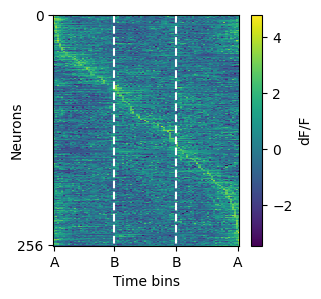

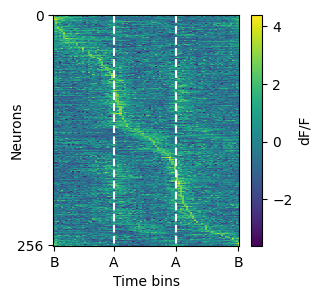

In [331]:
# Bin neural activity across each landmark within each ABB/BAA patch

# Find ABB and BAA patches 
ABB_patches, BAA_patches, ABB_patches_idx, BAA_patches_idx = alternation.get_XYY_patches(session, include_next=True)

# Bin neural activity 
binned_ABB_phase_activity = alternation.get_temporal_phase_binning_per_lm(tracked_neurons[session_idx], dF, ABB_patches, 
                                                        event_idx, bins=30, condition='ABB', plot=True)
binned_BAA_phase_activity = alternation.get_temporal_phase_binning_per_lm(tracked_neurons[session_idx], dF, BAA_patches, 
                                                        event_idx, bins=30, condition='BAA', plot=True)


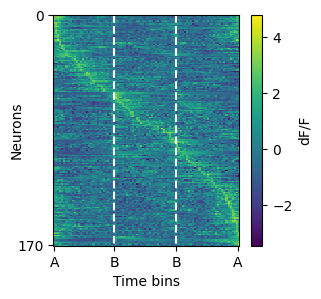

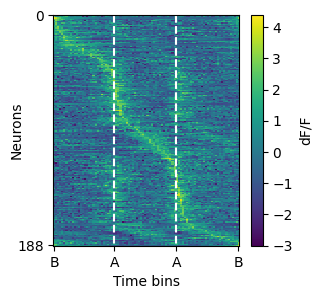

In [332]:
# Find cells with any peaks (== not just noise)
ABB_peak_cells = alternation.find_cells_with_ABB_peaks(tracked_neurons[session_idx], binned_ABB_phase_activity, condition='temporal', plot=False)
BAA_peak_cells = alternation.find_cells_with_ABB_peaks(tracked_neurons[session_idx], binned_BAA_phase_activity, condition='temporal', plot=False)

# Bin neural activity for each ABB/BAA patch using only cells with peaks
binned_ABB_phase_activity_peak_cells = alternation.get_temporal_phase_binning_per_lm(ABB_peak_cells, dF, ABB_patches, event_idx, bins=30, condition='ABB', plot=True)
binned_BAA_phase_activity_peak_cells = alternation.get_temporal_phase_binning_per_lm(BAA_peak_cells, dF, BAA_patches, event_idx, bins=30, condition='BAA', plot=True)

Identify neurons with different YY responses

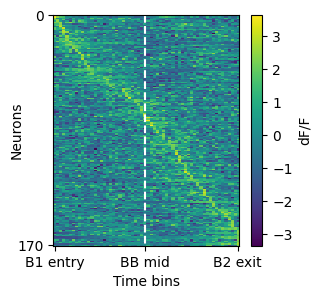

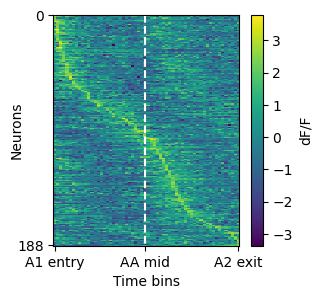

In [335]:
# Define patches again - with include_next requirement the last one might be included (XYYX)
ABB_patches, BAA_patches, ABB_patches_idx, BAA_patches_idx = alternation.get_XYY_patches(session, include_next=False)

# Use lm entry and exit idx
lm_entry_idx, lm_exit_idx = neural_analysis_helpers.get_lm_entry_exit(session)

# Find the midpoint between two YY events
BB_midpoint = [np.around(lm_exit_idx[lm[1]] + ((lm_entry_idx[lm[2]] - lm_exit_idx[lm[1]]) / 2)).astype(int) for lm in ABB_patches]
events_BB = {}
for i, lm in enumerate(ABB_patches):
    events_BB[lm[1]] = [lm_entry_idx[lm[1]], BB_midpoint[i]]
    events_BB[lm[2]] = [BB_midpoint[i], lm_exit_idx[lm[2]]]

AA_midpoint = [np.around(lm_exit_idx[lm[1]] + ((lm_entry_idx[lm[2]] - lm_exit_idx[lm[1]]) / 2)).astype(int) for lm in BAA_patches]
events_AA = {}
for i, lm in enumerate(BAA_patches):
    events_AA[lm[1]] = [lm_entry_idx[lm[1]], AA_midpoint[i]]
    events_AA[lm[2]] = [AA_midpoint[i], lm_exit_idx[lm[2]]]

# Bin activity by goal progress for the YY events 
binned_BB_phase_activity = alternation.get_temporal_phase_binning_per_lm(ABB_peak_cells, dF, ABB_patches, events_BB, bins=30, condition='BB', plot=True)
binned_AA_phase_activity = alternation.get_temporal_phase_binning_per_lm(BAA_peak_cells, dF, BAA_patches, events_AA, bins=30, condition='AA', plot=True)


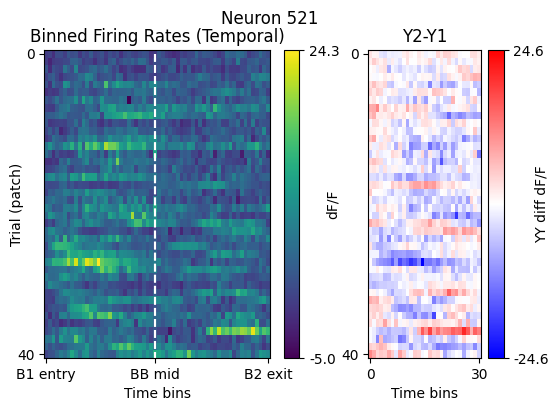

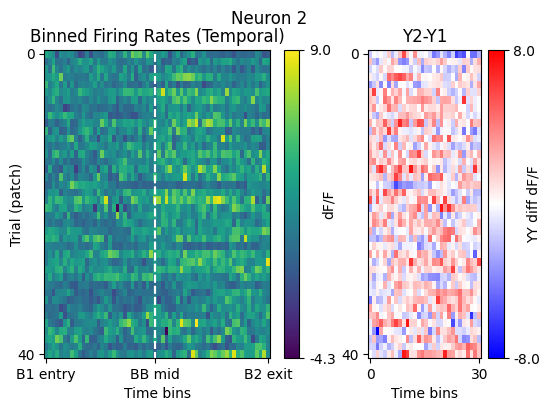

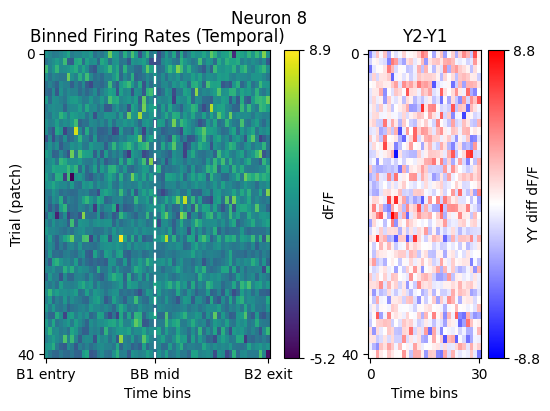

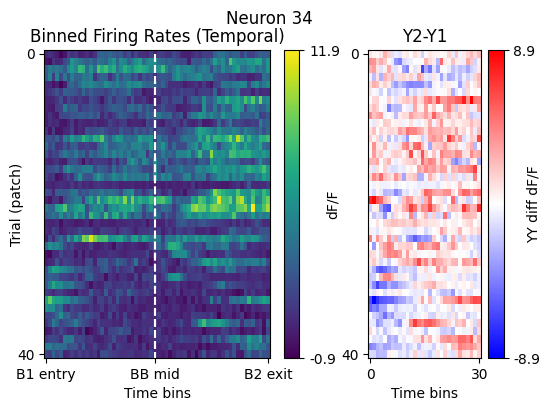

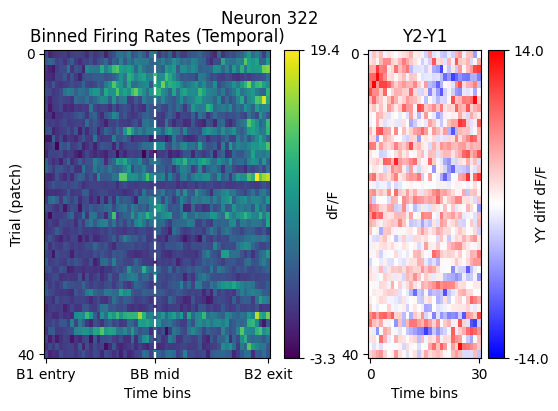

...

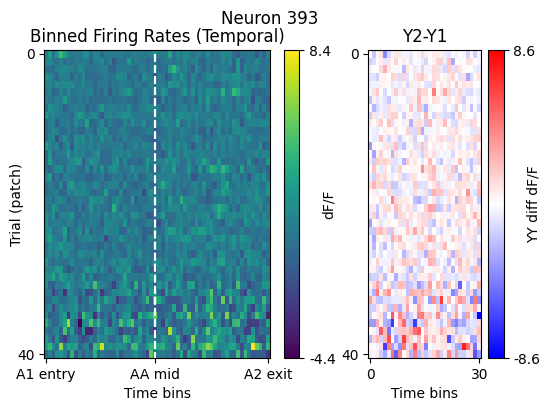

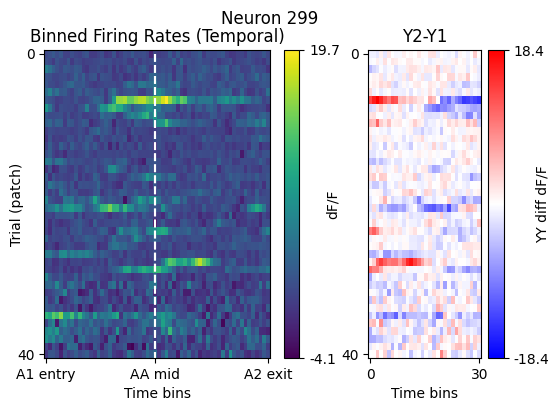

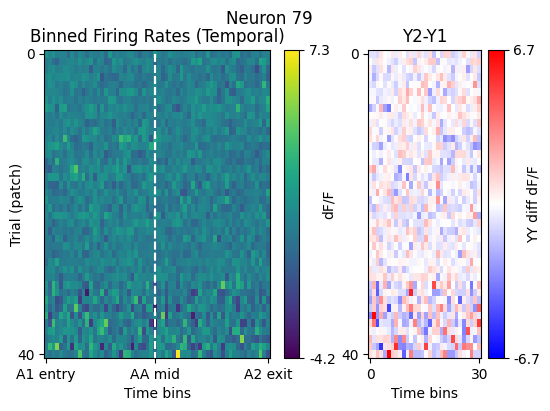

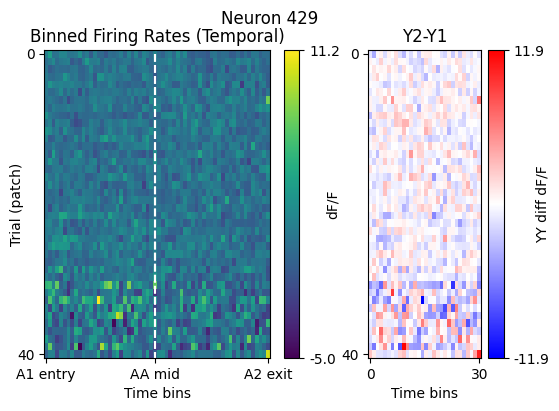

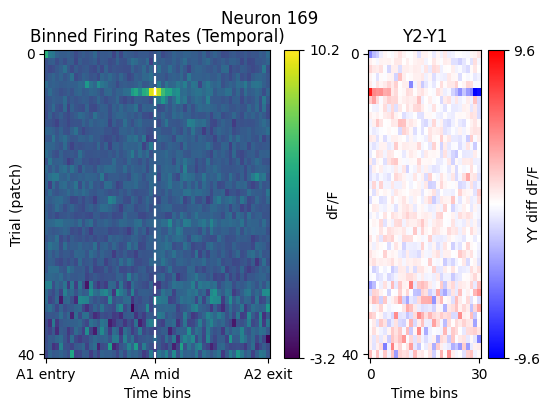

In [ ]:
# Get mean per binned lm per patch
BB_diff_cells = alternation.get_YY_diff_cells(ABB_peak_cells, binned_BB_phase_activity, condition='BB', plot=True)
AA_diff_cells = alternation.get_YY_diff_cells(BAA_peak_cells, binned_AA_phase_activity, condition='AA', plot=True)


Linear regression on the YY difference as a function of the number of preceding XY repeats

In [232]:
# Get the difference between two YYs 
bins = int(binned_BB_phase_activity['temporal_ABB_firing'][BB_diff_cells[0]].shape[1] / 2)

BB_diff = {}
for cell in BB_diff_cells:
    BB_diff[cell] = binned_BB_phase_activity['temporal_ABB_firing'][cell][:, bins:] - binned_BB_phase_activity['temporal_ABB_firing'][cell][:, :bins]
AA_diff = {}
for cell in AA_diff_cells:
    AA_diff[cell] = binned_AA_phase_activity['temporal_ABB_firing'][cell][:, bins:] - binned_AA_phase_activity['temporal_ABB_firing'][cell][:, :bins]

# Fit linear regression
# BB_slopes, BB_rvalues = alternation.fit_linear_regression_XYlen(BB_diff_cells, BB_diff, session4, condition='AB', plot=False)
# AA_slopes, AA_rvalues = alternation.fit_linear_regression_XYlen(AA_diff_cells, AA_diff, session4, condition='BA', plot=False)

# Fit linear regression with permutation test 
# BB_diff_regression_results = alternation.fit_linear_regression_XYlen_shuffle(BB_diff_cells, BB_diff, session, condition='AB', plot=True, shuffle=True, nreps=10000)
# AA_diff_regression_results = alternation.fit_linear_regression_XYlen_shuffle(AA_diff_cells, AA_diff, session, condition='BA', plot=True, shuffle=True, nreps=10000)


Cluster-based permutation analysis (CPA)

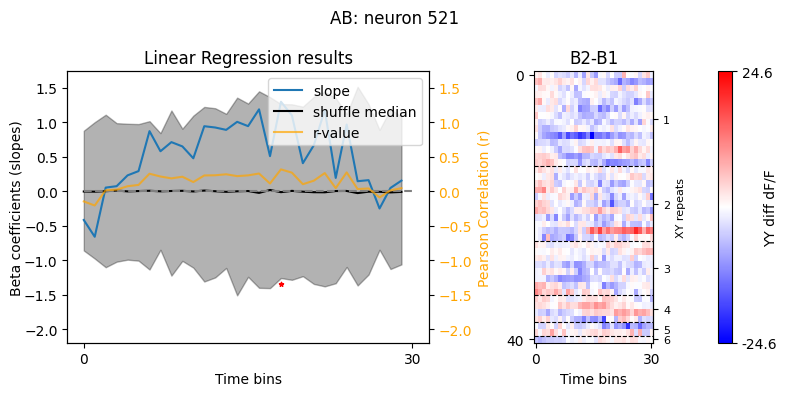

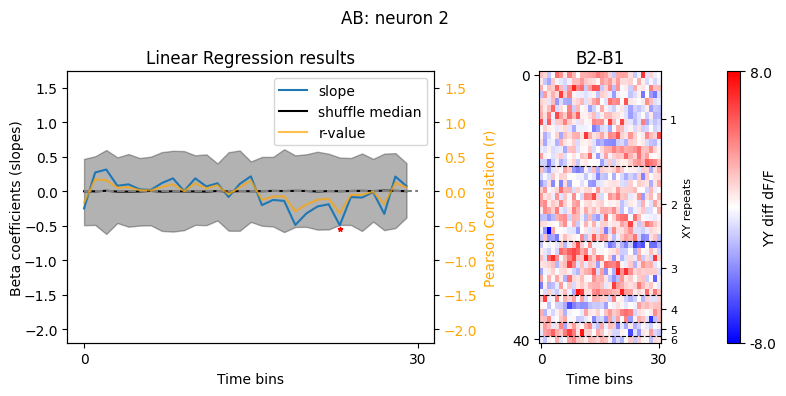

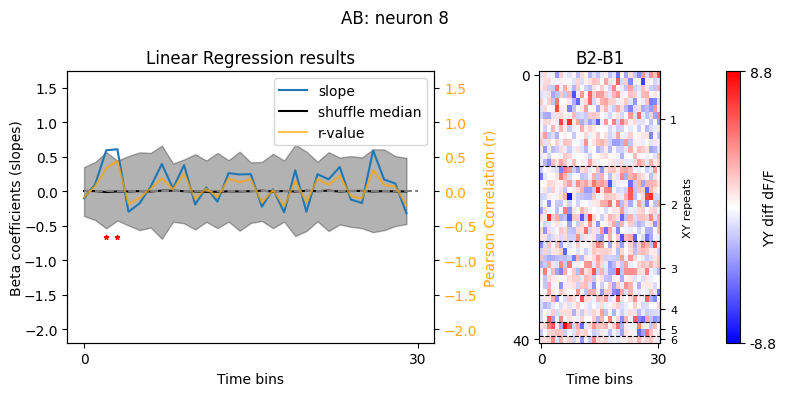

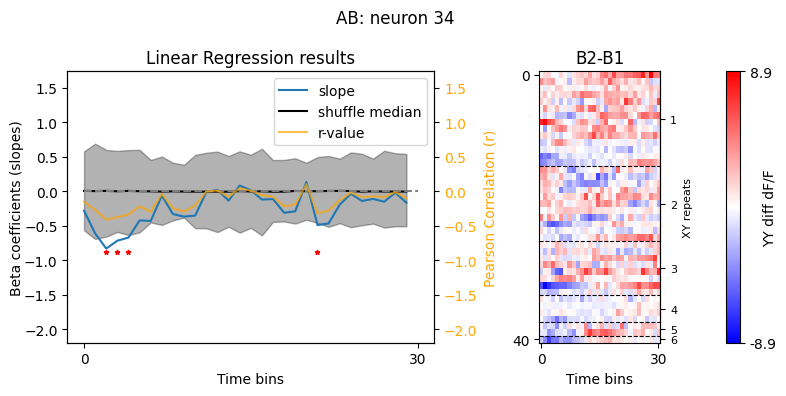

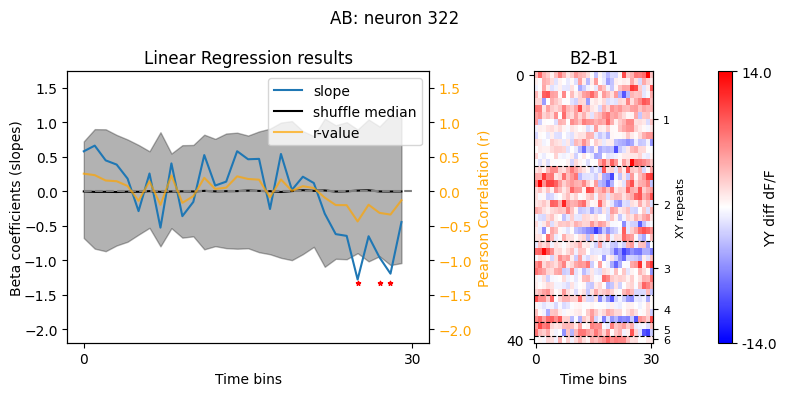

...

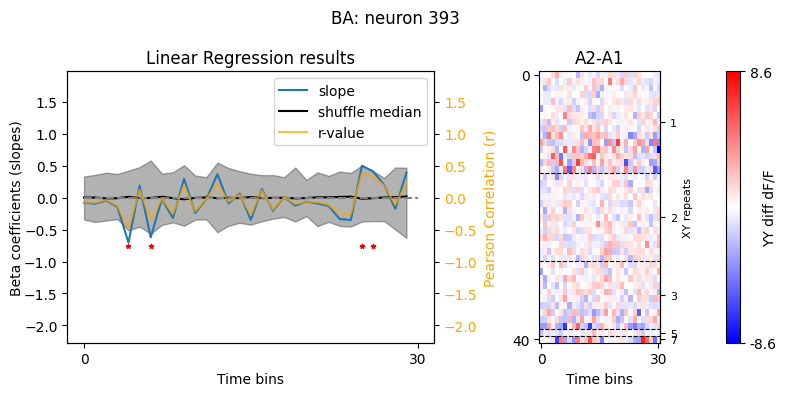

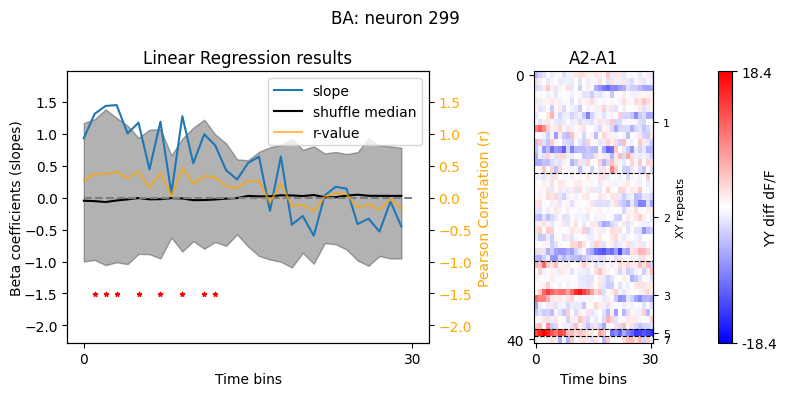

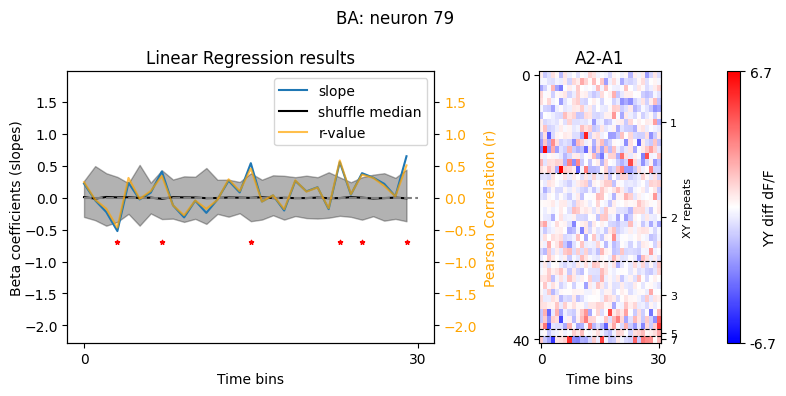

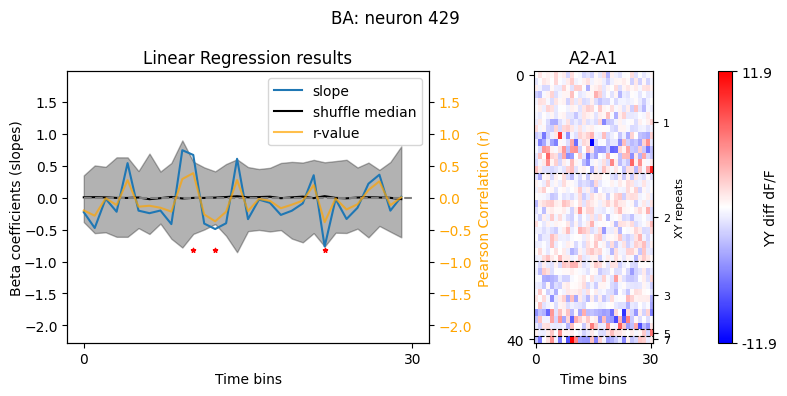

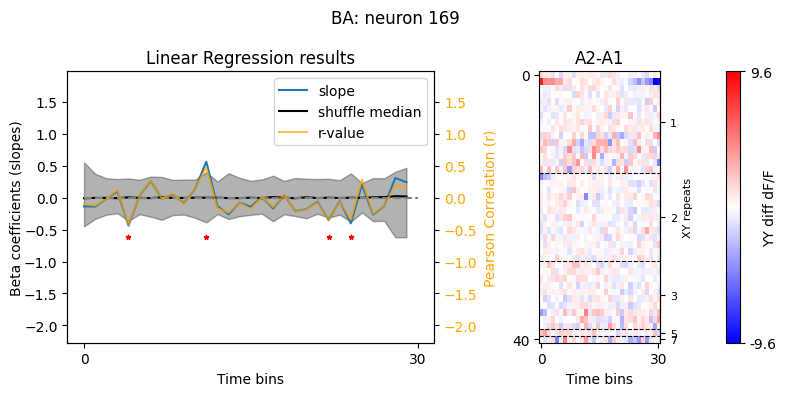

In [ ]:
# Cluster-based permutation analysis (CPA) 

BB_diff_regression_results_cpa = alternation.fit_linear_regression_XYlen_cpa(BB_diff_cells, BB_diff, session, condition='AB', shuffle=True, nreps=10000, cluster_thres=0.1, sort_heatmap=True)
AA_diff_regression_results_cpa = alternation.fit_linear_regression_XYlen_cpa(AA_diff_cells, AA_diff, session, condition='BA', shuffle=True, nreps=10000, cluster_thres=0.1, sort_heatmap=True)


Repeat the analysis above for all neurons

UnboundLocalError: local variable 'high_percentile' referenced before assignment

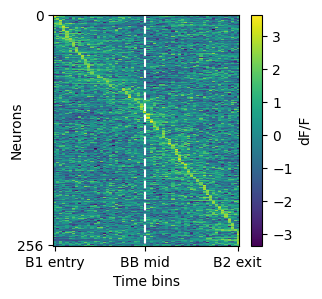

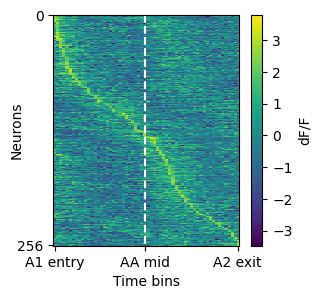

In [338]:
importlib.reload(alternation)

neurons = tracked_neurons[session_idx] 

# Temporal binning within XYY patch
all_neurons_binned_BB_phase_activity = alternation.get_temporal_phase_binning_per_lm(neurons, dF, ABB_patches, events_BB, bins=30, condition='BB', plot=True)
all_neurons_binned_AA_phase_activity = alternation.get_temporal_phase_binning_per_lm(neurons, dF, BAA_patches, events_AA, bins=30, condition='AA', plot=True)

bins = int(all_neurons_binned_BB_phase_activity['temporal_ABB_firing'][neurons[0]].shape[1] / 2)

# Compute YY difference
BB_diff = {}
for cell in neurons:
    BB_diff[cell] = all_neurons_binned_BB_phase_activity['temporal_ABB_firing'][cell][:, bins:] - all_neurons_binned_BB_phase_activity['temporal_ABB_firing'][cell][:, :bins]
AA_diff = {}
for cell in neurons:
    AA_diff[cell] = all_neurons_binned_AA_phase_activity['temporal_ABB_firing'][cell][:, bins:] - all_neurons_binned_AA_phase_activity['temporal_ABB_firing'][cell][:, :bins]

# Cluster-based permutation analysis (CPA)
save_dir = os.path.join(base_path, mouse, 't3_t4', 'analysis', f't{session_idx}_linear_regression_YY_diff_XYrepeats_cpa')

BB_diff_regession_results_t4 = alternation.fit_linear_regression_XYlen_cpa(neurons, BB_diff, session, condition='AB', shuffle=True, nreps=10000, 
                                                                                         cluster_thres=0.1, sort_heatmap=True, save_plot=True, save_dir=save_dir, 
                                                                                         plot_dir=save_dir, reload=False)
AA_diff_regession_results_t4 = alternation.fit_linear_regression_XYlen_cpa(neurons, AA_diff, session, condition='BA', shuffle=True, nreps=10000, 
                                                                                         cluster_thres=0.1, sort_heatmap=True, save_plot=True, save_dir=save_dir, 
                                                                                         plot_dir=save_dir, reload=False)


In [342]:
importlib.reload(alternation)
BB_diff_regession_results_t4 = alternation.fit_linear_regression_XYlen_cpa(neurons, BB_diff, session, condition='AB', shuffle=True, nreps=10000, 
                                                                                         cluster_thres=0.1, sort_heatmap=True, save_plot=True, save_dir=save_dir, 
                                                                                         plot_dir=save_dir, reload=False)
AA_diff_regession_results_t4 = alternation.fit_linear_regression_XYlen_cpa(neurons, AA_diff, session, condition='BA', shuffle=True, nreps=10000, 
                                                                                         cluster_thres=0.1, sort_heatmap=True, save_plot=True, save_dir=save_dir, 
                                                                                         plot_dir=save_dir, reload=False)


Linear regression with CPA file found. Loading...
Linear regression with CPA file found. Loading...


In [ ]:
# Select cells with any significant clusters - potential alternation candidates 

# Load data 
save_dir = os.path.join(base_path, mouse, 't3_t4', 'analysis', f't{session_idx}_linear_regression_YY_diff_XYrepeats_cpa')

BB_diff_regession_results_t4 = np.load(os.path.join(save_dir, f"AB_YY_diff_linear_regression_results.npz"), allow_pickle=True)
AA_diff_regession_results_t4 = np.load(os.path.join(save_dir, f"BA_YY_diff_linear_regression_results.npz"), allow_pickle=True)

# Select cells 
BB_cluster_pvalues = BB_diff_regession_results_t4['cluster_pvalue'].item()
BB_significant_cells_t4 = []
for cell, pval_dict in BB_cluster_pvalues.items():
    if pval_dict:  
        if any(p < 0.05 for p in pval_dict.values()):
            BB_significant_cells_t4.append(cell)

AA_cluster_pvalues = AA_diff_regession_results_t4['cluster_pvalue'].item()
AA_significant_cells_t4 = []
for cell, pval_dict in AA_cluster_pvalues.items():
    if pval_dict:  
        if any(p < 0.05 for p in pval_dict.values()):
            AA_significant_cells_t4.append(cell)

all_YY_diff_sig_cells_t4 = np.unique(np.concatenate([AA_significant_cells_t4, BB_significant_cells_t4]))


#### What are YY difference neurons doing in other sessions? 

##### T3

In [ ]:
# Find matching neurons in T3-T4
t4_neurons_idx = np.where(np.isin(idx_original_aligned[session_idx], all_YY_diff_sig_cells_t4))[0]
valid_neuron_mask = ~np.isnan(idx_original_aligned[3][t4_neurons_idx])
valid_neuron_idx = t4_neurons_idx[valid_neuron_mask] 

matching_t4_neurons = idx_original_aligned[session_idx][valid_neuron_idx].astype(int)
matching_t3_neurons = idx_original_aligned[3][valid_neuron_idx].astype(int)


In [ ]:
# Select session specific variables for the matching session to explore
session = session3
dF = dF_3
event_idx = event_idx3
matching_session_idx = 3
bins = 20
neurons = matching_t3_neurons


<module 'alternation_analysis_helpers' from '/Users/athinaapostolelli/Documents/SWC/VR_ABCD_project/VR_ABCD/alternation_analysis_helpers.py'>

Saved results to: /Volumes/mrsic_flogel/public/projects/AtApSuKuSaRe_20250129_HFScohort2/TAA0000066/t3_t4/analysis/t3_linear_regression_YY_diff_XYrepeats_cpa_t4_neurons/AB_YY_diff_linear_regression_results.npz
Saved results to: /Volumes/mrsic_flogel/public/projects/AtApSuKuSaRe_20250129_HFScohort2/TAA0000066/t3_t4/analysis/t3_linear_regression_YY_diff_XYrepeats_cpa_t4_neurons/BA_YY_diff_linear_regression_results.npz


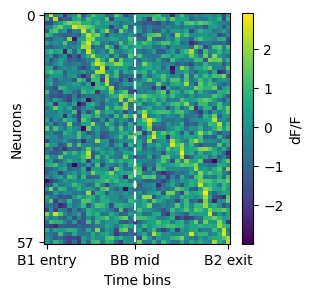

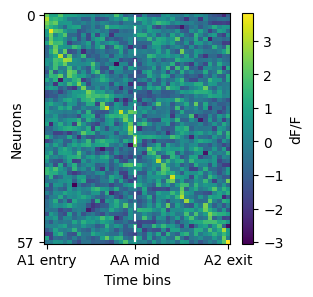

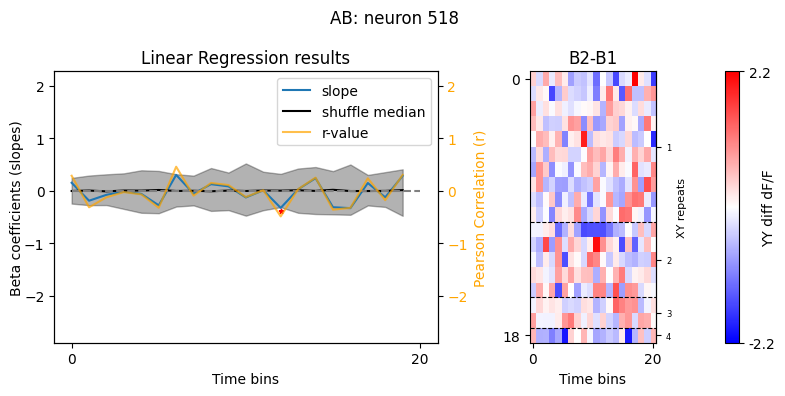

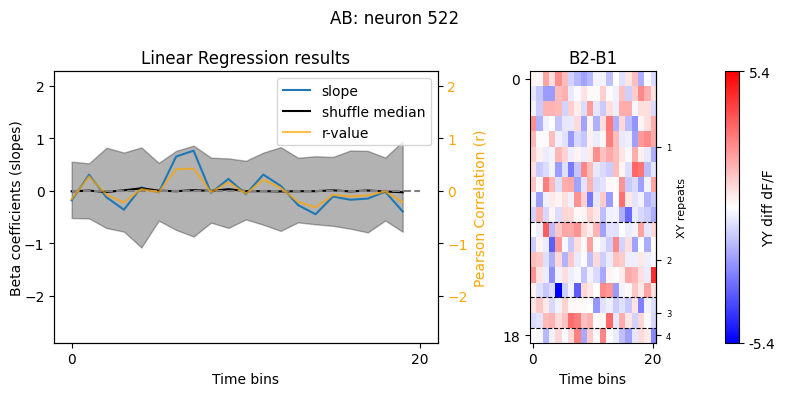

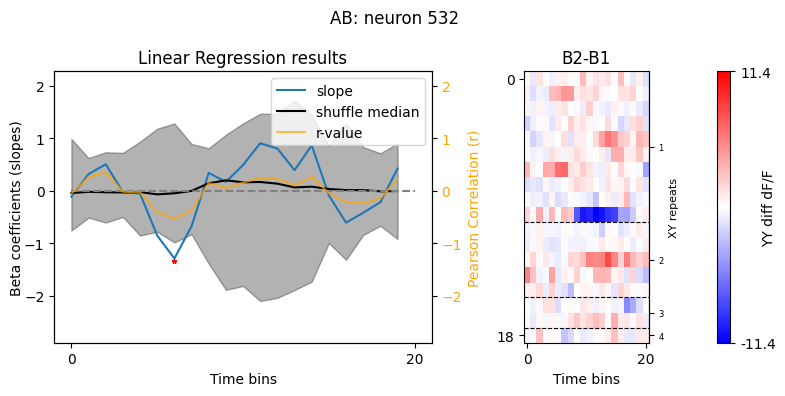

...

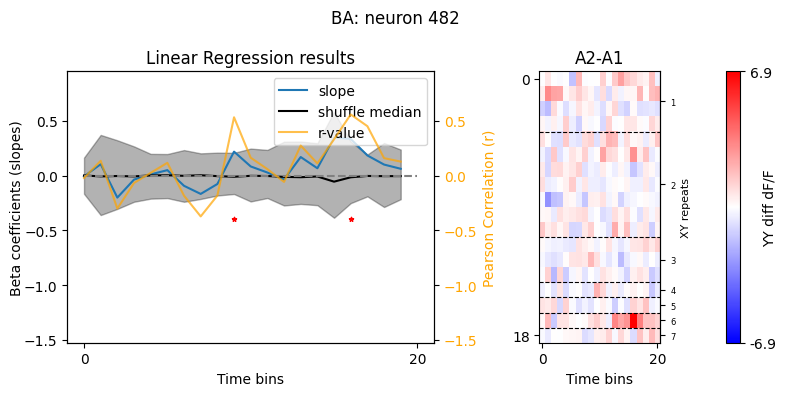

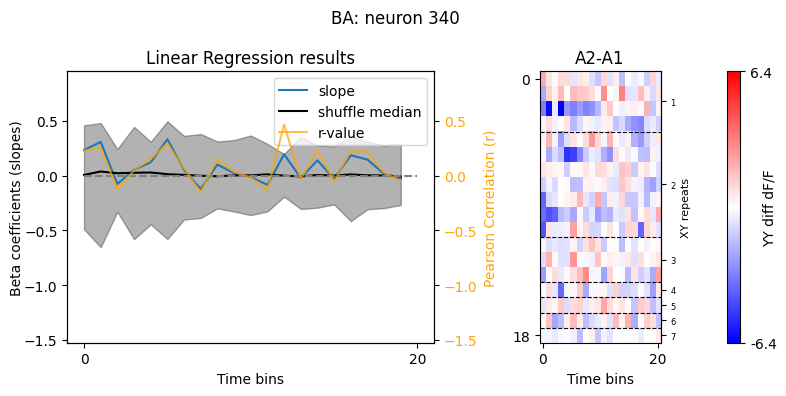

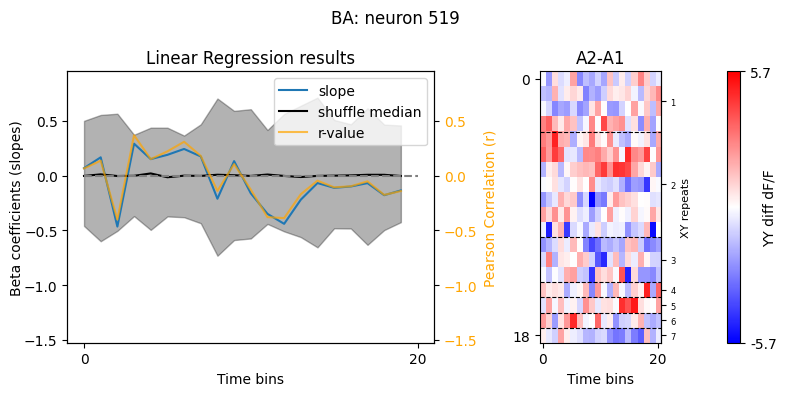

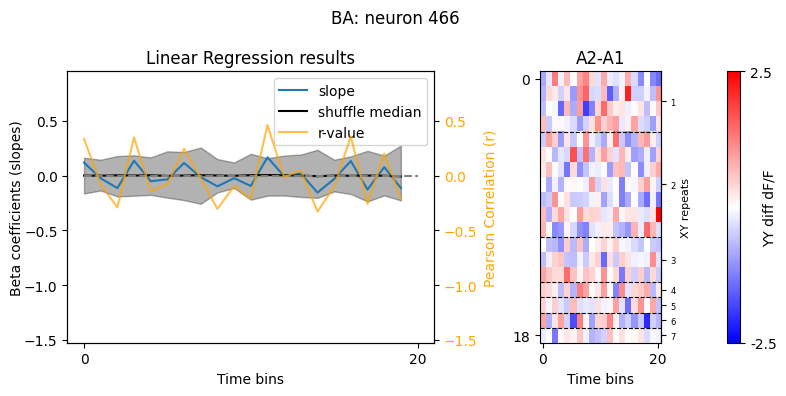

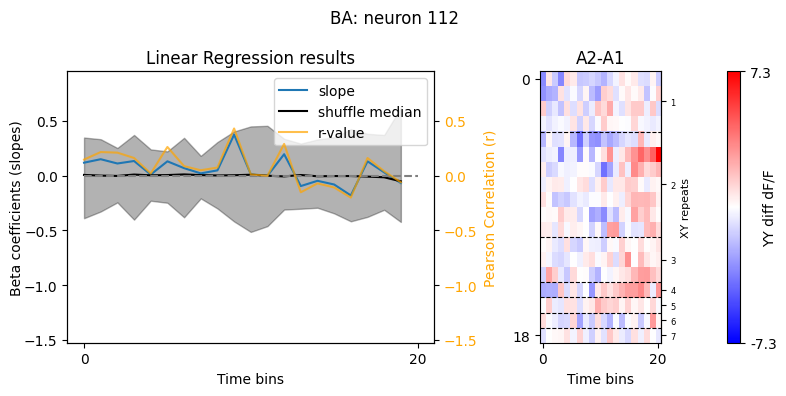

In [ ]:
# Define patches again - with include_next requirement the last one might be included (XYYX)
ABB_patches, BAA_patches, ABB_patches_idx, BAA_patches_idx = alternation.get_XYY_patches(session, include_next=False)

# Use lm entry and exit idx
lm_entry_idx, lm_exit_idx = neural_analysis_helpers.get_lm_entry_exit(session)

# Find the midpoint between two YY events
BB_midpoint = [np.around(lm_exit_idx[lm[1]] + ((lm_entry_idx[lm[2]] - lm_exit_idx[lm[1]]) / 2)).astype(int) for lm in ABB_patches]
events_BB = {}
for i, lm in enumerate(ABB_patches):
    events_BB[lm[1]] = [lm_entry_idx[lm[1]], BB_midpoint[i]]
    events_BB[lm[2]] = [BB_midpoint[i], lm_exit_idx[lm[2]]]

AA_midpoint = [np.around(lm_exit_idx[lm[1]] + ((lm_entry_idx[lm[2]] - lm_exit_idx[lm[1]]) / 2)).astype(int) for lm in BAA_patches]
events_AA = {}
for i, lm in enumerate(BAA_patches):
    events_AA[lm[1]] = [lm_entry_idx[lm[1]], AA_midpoint[i]]
    events_AA[lm[2]] = [AA_midpoint[i], lm_exit_idx[lm[2]]]

# Temporal binning within XYY patch
binned_BB_phase_activity = alternation.get_temporal_phase_binning_per_lm(neurons, dF, ABB_patches, events_BB, bins=bins, condition='BB', plot=True)
binned_AA_phase_activity = alternation.get_temporal_phase_binning_per_lm(neurons, dF, BAA_patches, events_AA, bins=bins, condition='AA', plot=True)

# Get the difference between two YYs 
BB_diff = {}
for cell in neurons:
    BB_diff[cell] = binned_BB_phase_activity['temporal_ABB_firing'][cell][:, bins:] - binned_BB_phase_activity['temporal_ABB_firing'][cell][:, :bins]
AA_diff = {}
for cell in neurons:
    AA_diff[cell] = binned_AA_phase_activity['temporal_ABB_firing'][cell][:, bins:] - binned_AA_phase_activity['temporal_ABB_firing'][cell][:, :bins]

# Cluster-based permutation analysis (CPA)
save_dir = os.path.join(base_path, mouse, 't3_t4', 'analysis', f't{matching_session_idx}_linear_regression_YY_diff_XYrepeats_cpa_t{session_idx}_neurons')

all_neurons_BB_diff_regression_results_cpa = alternation.fit_linear_regression_XYlen_cpa(neurons, BB_diff, session, condition='AB', shuffle=True, nreps=10000, cluster_thres=0.1, sort_heatmap=True, save_plot=True, save_dir=save_dir, plot_dir=save_dir)
all_neurons_AA_diff_regression_results_cpa = alternation.fit_linear_regression_XYlen_cpa(neurons, AA_diff, session, condition='BA', shuffle=True, nreps=10000, cluster_thres=0.1, sort_heatmap=True, save_plot=True, save_dir=save_dir, plot_dir=save_dir)


In [312]:
# Select cells with any significant clusters - potential alternation candidates 

# Load data 
save_dir = os.path.join(base_path, mouse, 't3_t4', 'analysis', f't{matching_session_idx}_linear_regression_YY_diff_XYrepeats_cpa_t{session_idx}_neurons')

BB_diff_regession_results_t3 = np.load(os.path.join(save_dir, f"AB_YY_diff_linear_regression_results.npz"), allow_pickle=True)
AA_diff_regession_results_t3 = np.load(os.path.join(save_dir, f"BA_YY_diff_linear_regression_results.npz"), allow_pickle=True)

# Select cells 
BB_cluster_pvalues = BB_diff_regession_results_t3['cluster_pvalue'].item()
BB_significant_cells_t3 = []
for cell, pval_dict in BB_cluster_pvalues.items():
    if pval_dict:  
        if any(p < 0.05 for p in pval_dict.values()):
            BB_significant_cells_t3.append(cell)

AA_cluster_pvalues = AA_diff_regession_results_t3['cluster_pvalue'].item()
AA_significant_cells_t3 = []
for cell, pval_dict in AA_cluster_pvalues.items():
    if pval_dict:  
        if any(p < 0.05 for p in pval_dict.values()):
            AA_significant_cells_t3.append(cell)

all_YY_diff_sig_cells_t3 = np.unique(np.concatenate([AA_significant_cells_t3, BB_significant_cells_t3]))


##### Τ5 & T6

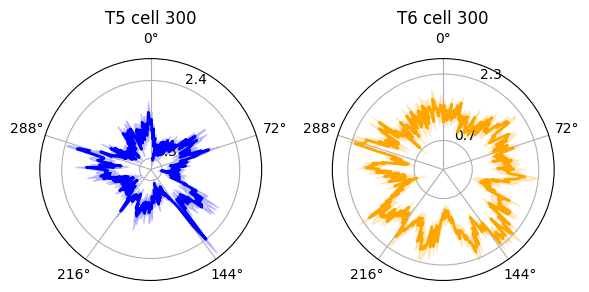

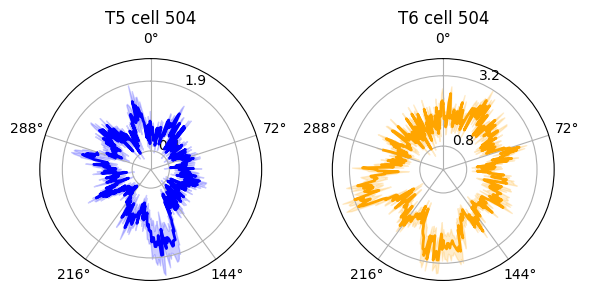

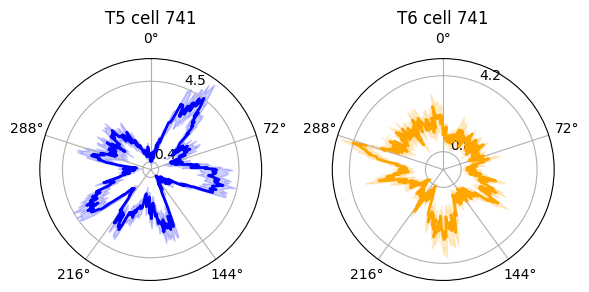

In [319]:
# Look at neurons that have significant clusters in both T3 and T4 
t3_neurons_idx = np.where(np.isin(idx_original_aligned[3], all_YY_diff_sig_cells_t3))[0] # cells already selected based on T4 significance
valid_neuron_mask = ~np.isnan(idx_original_aligned[5][t3_neurons_idx])
valid_neuron_idx = t3_neurons_idx[valid_neuron_mask] 

matching_t3_neurons = idx_original_aligned[3][valid_neuron_idx].astype(int)
matching_t5_neurons = idx_original_aligned[5][valid_neuron_idx].astype(int)
matching_t6_neurons = idx_original_aligned[6][valid_neuron_idx].astype(int)

# Plot T5 and T6 activity together for the cells above
for c, cell5, cell6 in zip(valid_neuron_idx, matching_t5_neurons, matching_t6_neurons):

    fig, axs = plt.subplots(1, 2, subplot_kw={'projection':'polar'}, figsize=(6, 3), facecolor='none')
    if not np.isnan(cell5):
        neural_analysis_helpers.plot_arb_progress(dF_5, cell5, event_frames=event_idx5, ngoals=5, bins=90, 
                                              stage=5, session=session5, labels=f'T5 cell {c}', ax=axs[0])

    if not np.isnan(cell6):
        neural_analysis_helpers.plot_arb_progress(dF_6, cell6, event_frames=event_idx6, ngoals=5, bins=90, 
                                              stage=6, session=session6, labels=f'T6 cell {c}', ax=axs[-1])
    
    plt.tight_layout()

### Ramping signal according to XY length

Linear regression on the activity in the last Y vs patch length i.e. number of preceding XYs

In [ ]:
# Select session specific variables 
session = session3
dF = dF_3
event_idx = event_idx3
session_idx = 3

In [79]:
binned_lastB_patch_activity, avg_lastB_patch_length_activity = alternation.get_binning_by_XY_patch_length(tracked_neurons[session_idx], session, dF, condition='AB', bins=20, plot=False, last_lm=True)
binned_lastA_patch_activity, avg_lastA_patch_length_activity = alternation.get_binning_by_XY_patch_length(tracked_neurons[session_idx], session, dF, condition='BA', bins=20, plot=False, last_lm=True)

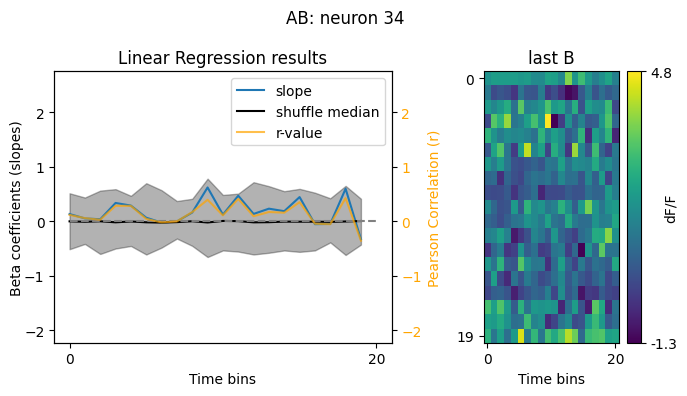

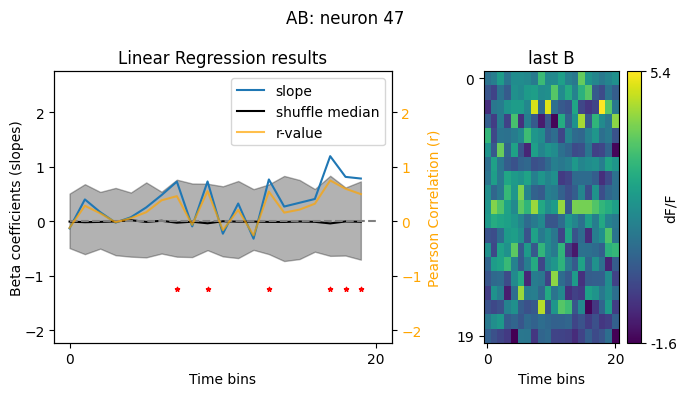

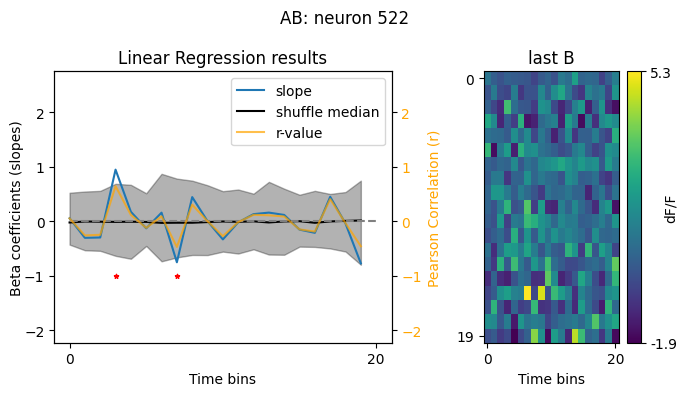

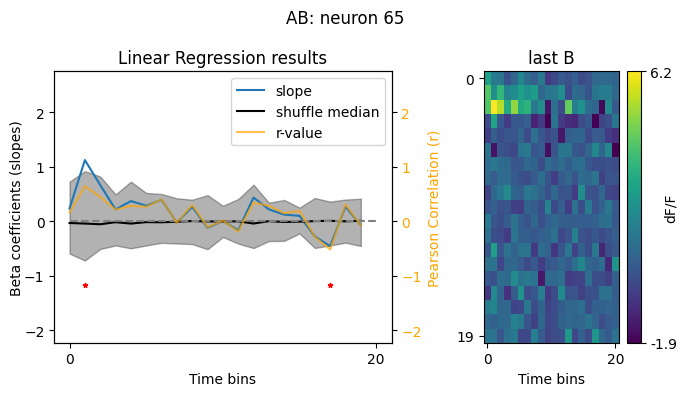

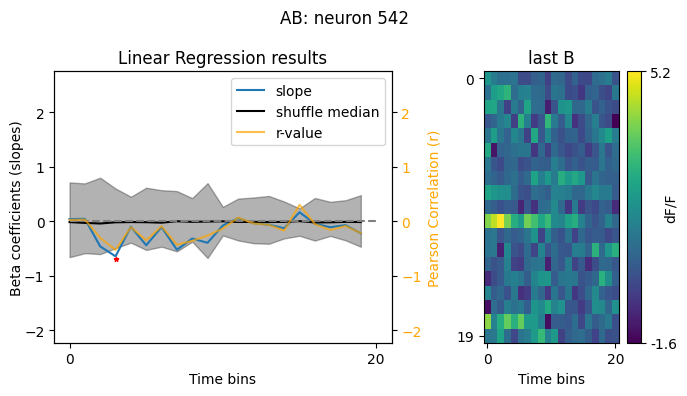

...

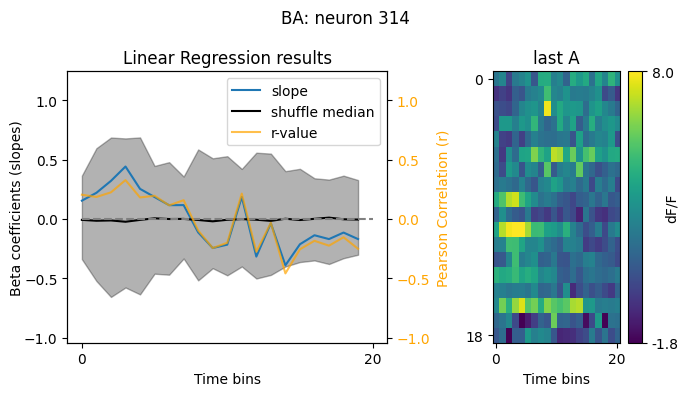

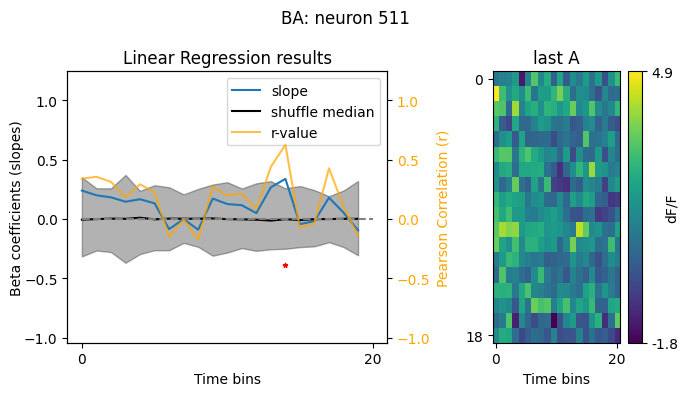

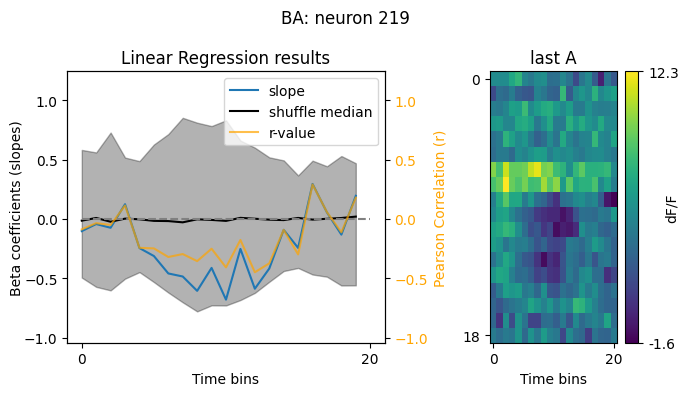

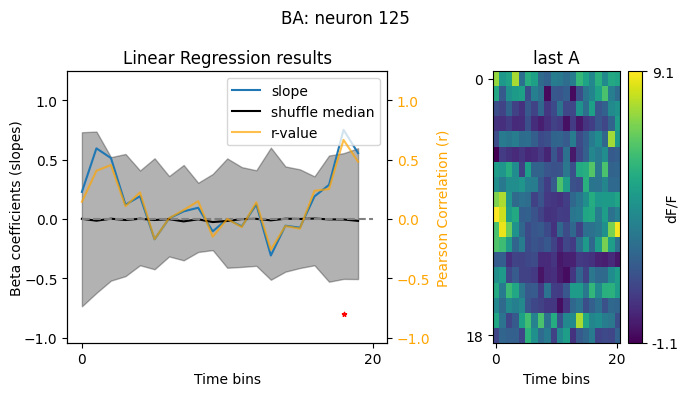

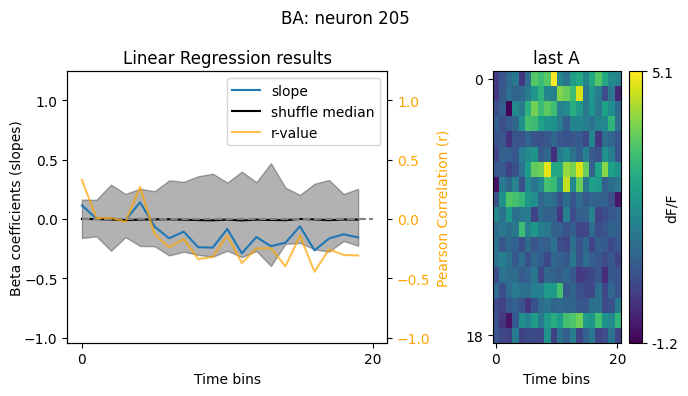

In [ ]:
# Fit linear regression
_, _ = alternation.fit_linear_regression_XYlen(tracked_neurons[session_idx], binned_lastB_patch_activity, session, condition='AB', data_type='last_Y', plot=False)
_, _ = alternation.fit_linear_regression_XYlen(tracked_neurons[session_idx], binned_lastA_patch_activity, session, condition='BA', data_type='last_Y', plot=False)


In [ ]:
# TODO fit linear regression on all neurons and select putative ramping neurons based on stats 
# putative_ramping_neurons_B = [513, 525, 521, 512, 34, 383, 322, 101, 160, 190, 165, 226, 345, 192, 365, 317, 332, 222, 224, 524, 530, 275, 270, 266, 318, 307, 188, 469] # AB T4
# putative_ramping_neurons_A = [459, 521, 512, 383, 101, 165, 345, 363, 317, 224, 524, 522, 253, 270, 299, 469] # BA T4
putative_ramping_neurons_B = [34, 47, 522, 65, 542, 565, 580, 89, 81, 108, 124, 28, 429, 524, 402, 196, 406, 389, 408, 397, 380, 242, 260, 359, 361, 438, 457, 349, 314, 419, 358, 115, 125, 519, 112] # AB T3
putative_ramping_neurons_A = [39, 492, 86, 479, 28, 429, 165, 524, 188, 260, 344, 569, 390, 314, 511, 219, 125, 205] # AB T3

# Fit linear regression with permutation test on cells that look significant
_, _, _, _, _ = alternation.fit_linear_regression_XYlen_shuffle(putative_ramping_neurons_B, binned_lastB_patch_activity, session, condition='AB', data_type='last_Y', plot=True, shuffle=True, nreps=10000)
_, _, _, _, _ = alternation.fit_linear_regression_XYlen_shuffle(putative_ramping_neurons_A, binned_lastA_patch_activity, session, condition='BA', data_type='last_Y', plot=True, shuffle=True, nreps=10000)


### PSTH by patch length

Find neurons with PSTH for **last** Y in patch scaled by patch length

In [84]:
# Select session specific variables 
session = session3
dF = dF_3
event_idx = event_idx3
session_idx = 3

In [ ]:
# Get neurons with differential last B response across patch lengths
lastB_psth, lastB_avg_psth = alternation.get_Y_psth(tracked_neurons[session_idx], session, dF, event_idx, condition='AB', lm='last_Y', time_around=(-0.5,1), plot=False)

interesting_neurons_lastB = [32, 525, 132, 160, 165, 192, 363, 365, 332, 224, 245, 266, 82, 188, 275]
_, _ = alternation.get_Y_psth(interesting_neurons_lastB, session, dF, event_idx, condition='AB', lm='last_Y', time_around=(-0.5,1), plot=True)

# Get neurons with differential last A response across patch lengths
lastA_psth, lastA_avg_psth = alternation.get_Y_psth(tracked_neurons[session_idx], session, dF, event_idx, condition='BA', lm='last_Y', time_around=(-0.5,1), plot=False)

interesting_neurons_lastA = [469, 365, 317, 363, 192, 276, 101]
_, _ = alternation.get_Y_psth(interesting_neurons_lastA, session, dF, event_idx, condition='BA', lm='last_Y', time_around=(-0.5,1), plot=True)


Find neurons with PSTH for **next** Y after alternation violation scaled by patch length

In [ ]:
# Get neurons with differential next B response across patch lengths
nextB_psth, nextB_avg_psth = alternation.get_Y_psth(tracked_neurons[session_idx], session, dF, event_idx, condition='AB', lm='next_Y', time_around=(-0.5,1), plot=False)

interesting_neurons_nextB = [525, 34, 383, 160, 190, 276, 365, 332, 524, 246, 245, 420, 275, 318, 188, 35]
_, _ = alternation.get_Y_psth(interesting_neurons_nextB, session, dF, event_idx, condition='AB', lm='next_Y', time_around=(-0.5,1), plot=True)

# Get neurons with differential next A response across patch lengths
nextA_psth, nextA_avg_psth = alternation.get_Y_psth(tracked_neurons[session_idx], session, dF, event_idx, condition='BA', lm='next_Y', time_around=(-0.5,1), plot=False)

interesting_neurons_nextA = [13, 34, 101, 161, 192, 363, 311, 224, 305, 466, 284, 451, 82, 299, 469]
_, _ = alternation.get_Y_psth(interesting_neurons_nextA, session, dF, event_idx, condition='BA', lm='next_Y', time_around=(-0.5,1), plot=True)


Get the PSTH for Y1 and Y2 for the neurons selected in the analyses above

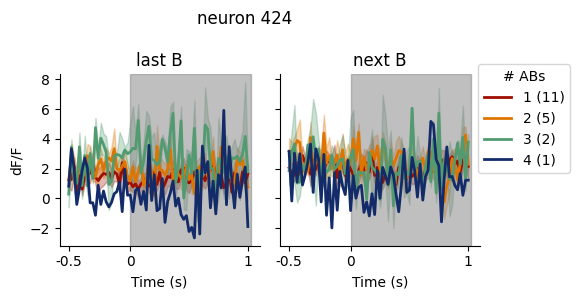

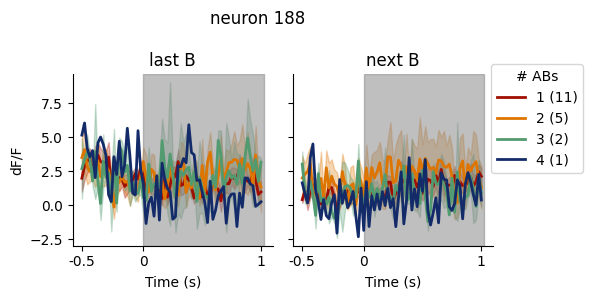

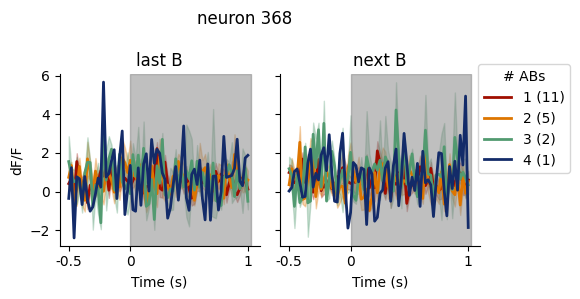

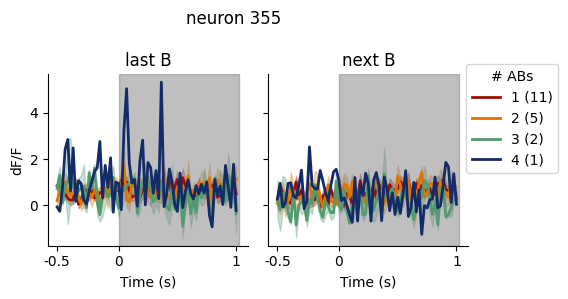

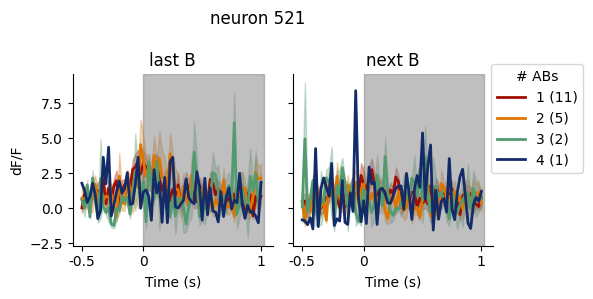

...

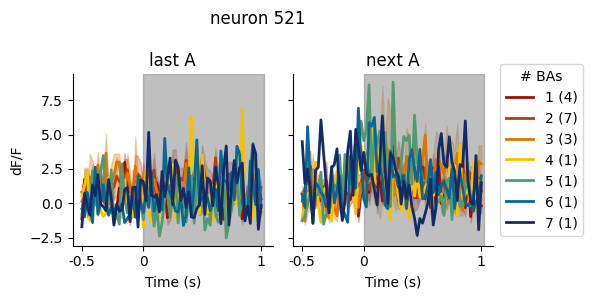

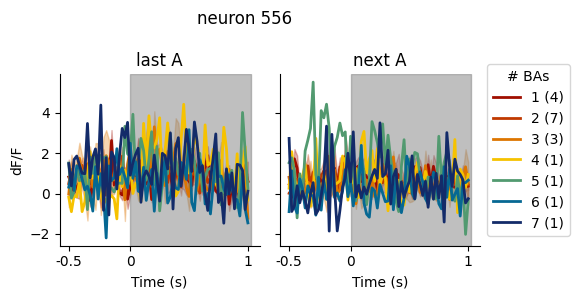

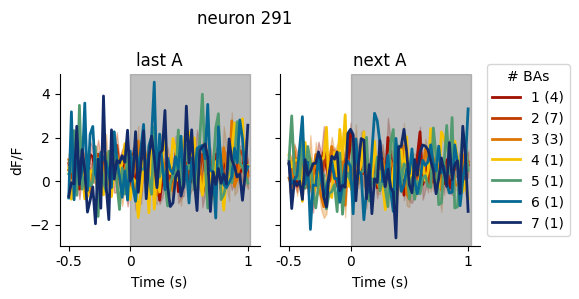

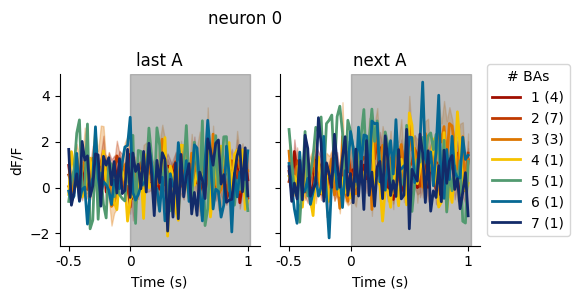

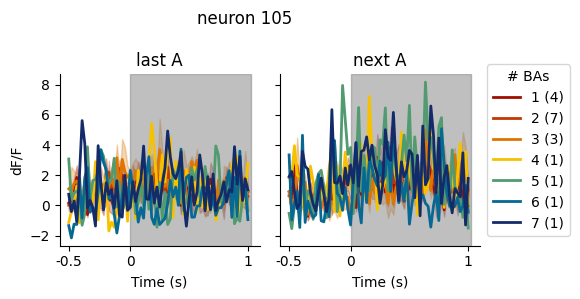

In [91]:
# Get the PSTH for Y1 and Y2 for the neurons with significant YY difference 
_, _, _, _ = alternation.get_YY_psth(BB_diff_cells, session, dF, event_idx, condition='AB', time_around=(-0.5,1), plot=True)
_, _, _, _ = alternation.get_YY_psth(AA_diff_cells, session, dF, event_idx, condition='BA', time_around=(-0.5,1), plot=True)


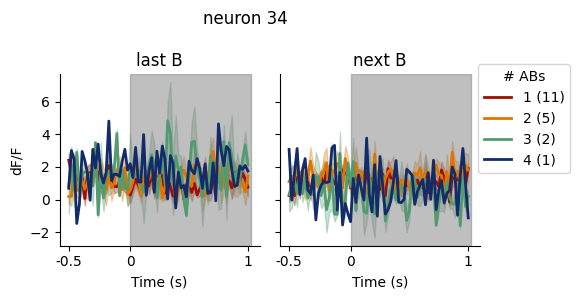

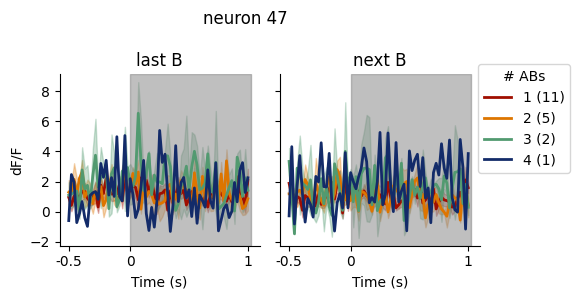

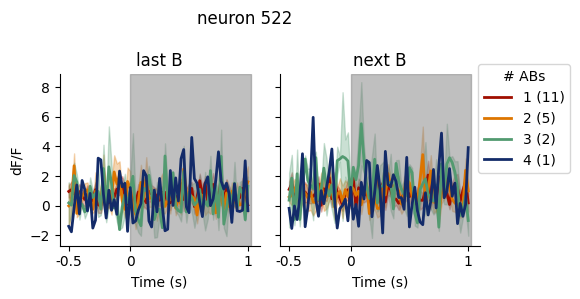

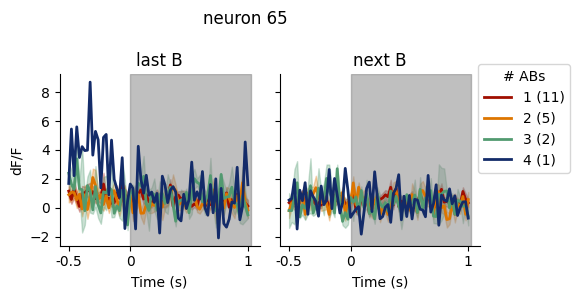

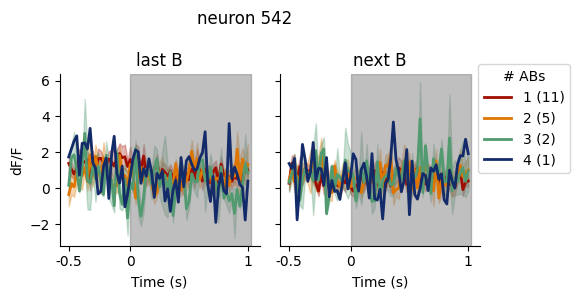

...

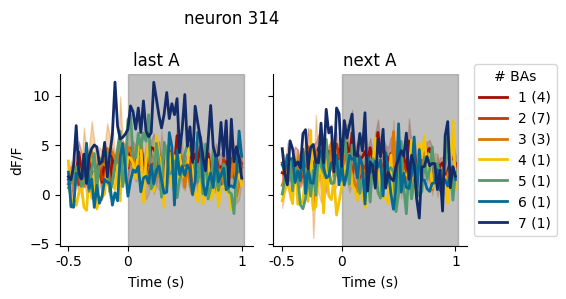

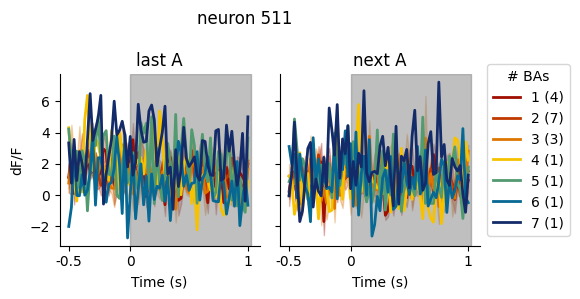

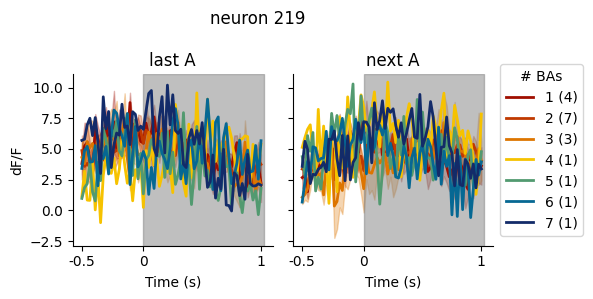

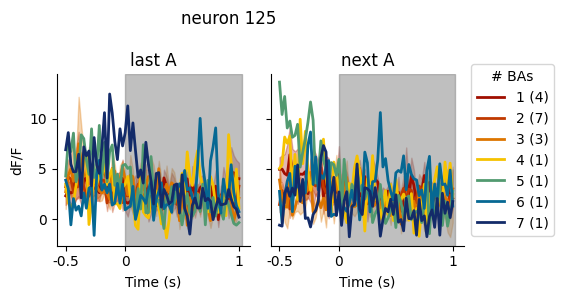

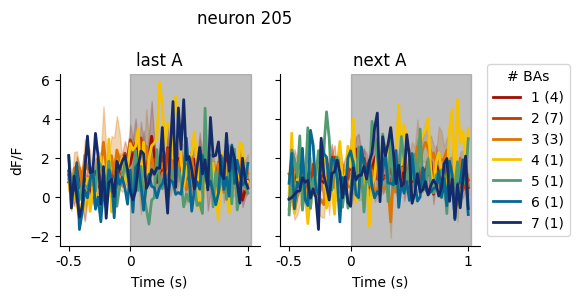

In [89]:
# Get the PSTH for Y1 and Y2 for the neurons with changing activity based on number of XYs before 
_, _, _, _ = alternation.get_YY_psth(putative_ramping_neurons_B, session, dF, event_idx, condition='AB', time_around=(-0.5,1), plot=True)
_, _, _, _ = alternation.get_YY_psth(putative_ramping_neurons_A, session, dF, event_idx, condition='BA', time_around=(-0.5,1), plot=True)
